<a href="https://colab.research.google.com/github/Sookchand/Conditional-Gan-to-Generate-New-Image/blob/main/Lab9_Conditional_GAN_for_image_generation_of_Cifar10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive # Mount the google drive for data loading
drive.mount('/content/drive')

Mounted at /content/drive


# Import some related dependencies
1.   Numpy: a package for array transformation
2.   Scipy: a package for loading data with (.mat) format
3.   Matplotlib: a package for data visualization
4.   Random: a package for randomly select samples
5.   Skearn: a package including many machine learning approaches
6.   Tensorflow: a package for neural networks modeling
7.   Keras: a package for neural networks modeling which is established on Tensorflow

In [ ]:
import numpy as np #helps for array operation
import scipy.io as sio #helps to read the data
import matplotlib.pyplot as plt #helps with graphical plots
import random #helps choose random samples
from sklearn.preprocessing import OneHotEncoder #helps for label one-hot encoding
import tensorflow as tf #helps for ANN model construction
import keras #helps for ANN model construction
from keras.datasets import cifar10 #helps for loading cifar10 dataset

# Test the GPU

In [ ]:
device_name = tf.test.gpu_device_name()  # Current GPU name 
if device_name != '/device:GPU:0':       # Test if the GPU exists
  raise SystemError('GPU device not found')
print('Found GPU at: {}'.format(device_name)) 

Found GPU at: /device:GPU:0


# Visualizaiton of raw images

In [ ]:
(trainX, trainY), (_, _) = cifar10.load_data() # Download the Cifar10 data online. Only the training dataset will be used for GAN training.

170508288/170498071 [==============================] - 6s 0us/step


In [ ]:
print (trainX.shape)
print (trainY.shape)

(50000, 32, 32, 3)
(50000, 1)


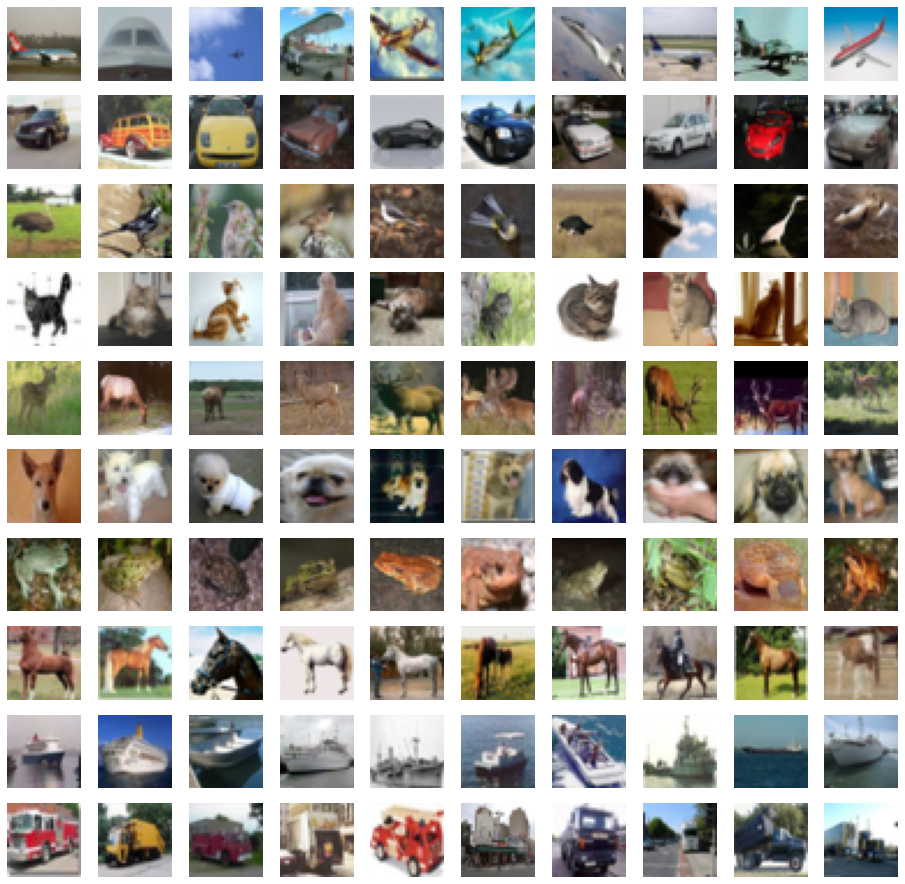

In [ ]:
ix = []
for i in range(10):   
  ix = ix + random.sample(list(np.where(trainY==i)[0]), 10)                   # Randomly choose 10 indices from each class, total 100 indices
X = trainX[ix]		                                                            # Choose 10*10 samples as the selected index
plt.figure(figsize=(16,16))                                                   # Set the whole figure size 
for i in range(10 * 10):           	                                          # Plot images
  plt.subplot(10, 10, 1 + i)                                                  # Define subplot
  plt.axis('off')									                                            # Turn off axis, only show the generated images
  plt.imshow(X[i]/255)                                                        # Show the images after converting the image to [0,1]
plt.show()

#Define a discriminator
The discriminator is used to try to discriminate the generated samples and real samples.

In [ ]:
def define_discriminator(in_shape=(32,32,3)):   																	# A function with one parameter of input shape 
	in_label = keras.layers.Input(shape=(1,))                                       # Shape of label 
	li = keras.layers.Embedding(10, 50)(in_label)																		# Embedding for categorical input
	li = keras.layers.Dense(32 * 32 *3)(li)																					# Transformation to a 1-D image shape 
	li = keras.layers.Reshape((32, 32, 3))(li)																			# Reshape to an 3-D image shape 
	in_image = keras.layers.Input(shape=in_shape)																		# Image input
	merge = keras.layers.Concatenate()([in_image, li])															# Merge label and input
	fe = keras.layers.Conv2D(128, (3,3), strides=(2,2), padding='same')(merge)     	# Convolutional layer with 128 filters. Kernel size is (3,3), stride is (2,2)
	fe = keras.layers.LeakyReLU(alpha=0.2)(fe)																			# Leaky ReLU activation function with a slope of 0.2
	fe = keras.layers.Conv2D(128, (3,3), strides=(2,2), padding='same')(fe)					# Convolutional layer with 128 filters. Kernel size is (3,3), stride is (2,2)
	fe = keras.layers.LeakyReLU(alpha=0.2)(fe)																			# Leaky ReLU activation function with a slope of 0.2
	fe = keras.layers.Flatten()(fe)																									# Reshape the previous output to a 1-dimension vector
	fe = keras.layers.Dropout(0.4)(fe)																							# Alleviate overfitting with a dropout layer 
	out_layer = keras.layers.Dense(1, activation='sigmoid')(fe)											# Output layer with activation function of Sigmoid (Output is in (0,1))
	model = keras.models.Model([in_image, in_label], out_layer)                     # Define model, image and label are taken as input
	opt = tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5)														# Set the learning rate of Adam optimizer
	model.compile(loss='binary_crossentropy', optimizer=opt, metrics=['accuracy'])  # Compile the model with the optimizer, a loss of binary crossentropy, and an accuracy metric
	model.summary()																																	# Summary the discriminator
	return model 

#Define a generator
The generator is used to generate fake samples

In [ ]:
def define_generator(latent_dim):                                                   # A function with one parameter of input dimension 
	in_label = keras.layers.Input(shape=(1,))																					# Shape of label 
	li = keras.layers.Embedding(10, 50)(in_label)																			# Embedding for categorical input
	li = keras.layers.Dense(8 * 8 * 3)(li)																						# Mapping data to a high-dimension space
	li = keras.layers.Reshape((8, 8, 3))(li)																					# Reshape data to a 3-D format
	in_lat = keras.layers.Input(shape=(latent_dim,))																	# Shape of input noise														
	gen = keras.layers.Dense(128 * 8 * 8)(in_lat)																			# Mapping input to a high dimension space
	gen = keras.layers.LeakyReLU(alpha=0.2)(gen)																			# Leaky ReLU activation function with a slope of 0.2
	gen = keras.layers.Reshape((8, 8, 128))(gen)																			# Reshape data to a 3-D format
	merge = keras.layers.Concatenate()([gen, li])																			# Merge image and label
	gen = keras.layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(merge) # Transposed convolutional layer with 128 filters. Kernel size is (4,4), stride is (2,2)
	gen = keras.layers.LeakyReLU(alpha=0.2)(gen)																			# Leaky ReLU activation function with a slope of 0.2
	gen = keras.layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same')(gen)# Transposed convolutional layer with 128 filters. Kernel size is (4,4), stride is (2,2)
	gen = keras.layers.LeakyReLU(alpha=0.2)(gen)																			# Leaky ReLU activation function with a slope of 0.2
	out_layer = keras.layers.Conv2D(3, (3,3), strides=(1,1),activation='tanh', padding='same')(gen) # Convolutional layer with 3 filters. Kernel size is (3,3), stride is (1,1), activation function is tanh (-1,1). The final output shape is 32x32x3, which is an CIFAR10 image.
	model = keras.models.Model([in_lat, in_label], out_layer)													# Define model
	model.summary()																																		# Summary the generator
	return model

#Define the GAN model based on discriminator and generator
The weights in discriminator are fixed, and GAN model only updates the weights in generator.

In [ ]:
def define_gan(g_model, d_model):												   							# A function with two parameters: discriminator model and generator model 
	d_model.trainable = False																							# Make weights in the discriminator not trainable
	gen_noise, gen_label = g_model.input																	# Get input noise and label from generator model
	gen_output = g_model.output																						# Get image output from the generator model
	gan_output = d_model([gen_output, gen_label])													# Connect image output and label input from generator as inputs to discriminator
	model = keras.models.Model([gen_noise, gen_label], gan_output)				# Define gan model as taking input noise and label, and outputting a real/fake
	opt = tf.keras.optimizers.Adam(lr=0.0002, beta_1=0.5)									# Set the learning rate of Adam optimizer
	model.compile(loss='binary_crossentropy', optimizer=opt)							# Compile the model with the optimizer, a loss of binary crossentropy, and an accuracy metric
	model.summary()																												# Summary the GAN model
	return model

# Load the real images

1.   Import the Cifar10.mat data
2.   Sample one sample every ten samples
3.   Convert data from unsigned ints to floats
4.   Normalize the data [0, 255] to an interval of [-1, 1]

In [ ]:
def load_real_samples():                                                              		# Data and labels of real samples, take one sample every 10 samples
	X, Y = trainX[::10], trainY[::10]																												
	X = X.astype('float32')                                                        					# Convert data from unsigned ints to floats
	X = (X - 127.5) / 127.5                               																	# Scale data from [0,255] to [-1,1]
	return [X, Y]

# Select real images and define labels

In [ ]:
def generate_real_samples(dataset, n_samples):                  	   # A function with two parameters: dataset and the number of samples in a batch
	images, labels = dataset	
	ix = np.random.randint(0, images.shape[0], n_samples)				 		   # Choose n_samples random instances
	X, Y = images[ix], labels[ix]																								
	y = np.ones((n_samples, 1)) 																			 # Define the labels of real images using 1
	return [X,Y], y

# Generate dataset for the generator

In [ ]:
def generate_latent_points(latent_dim, n_samples):    # A function with two parameters: input dimension and the number of generated samples in a batch
	x_input = np.random.randn(latent_dim * n_samples) 	# Generate random noise vector with a length of latent_dim * n_samples
	x_input = x_input.reshape(n_samples, latent_dim)    # Reshape data into a batch of inputs for the generator
	labels = np.random.randint(0, 10, n_samples)        # Generate n_samples integer labels in the interval [0, 10]
	return [x_input, labels]

# Generate fake samples using the generator

In [ ]:
def generate_fake_samples(g_model, latent_dim, n_samples):           							# A function with three parameters: generator model, input dimension and the number of generated samples in a batch
	x_input, labels_input = generate_latent_points(latent_dim, n_samples)           # Generate input and its label for the generator
	X = g_model.predict([x_input, labels_input])																	 	# Predict outputs, i.e., generate fake samples 
	y = np.zeros((n_samples, 1))                         														# Define the labels of fake images using 0
	return [X, labels_input], y

# Display the generated images

In [ ]:
def plot_generate(examples, n = 7): # A function with three parameters: generated images, the number of images n^2 once displayed. Default n is 7, you can change it.
	plt.figure(figsize=(12,12))       # Set the whole figure size 
	examples = (examples + 1) / 2.0  	# Scale generated images from [-1,1] to [0,1]
	for i in range(n * n):           	# Plot images
		plt.subplot(n, n, 1 + i)        # Define subplot
		plt.axis('off')									# Turn off axis, only show the generated images
		plt.imshow(examples[i])         # Show the images
	plt.show()
	plt.close()

# Train the generator and discriminator


1.   Train discriminator using a half batch of real images 
2.   Train discriminator using a half batch of fake images 
3.   Generate a batch of fake samples and define their labels as real images (i.e., [0, 1])
4.   Train generator using a batch of fake images



In [ ]:
def train(g_model, d_model, gan_model, dataset, latent_dim, n_epochs=500, n_batch=128): 								# Define the training model, n_epochs = 500, batch size = 128.
	bat_per_epo = int(dataset[0].shape[0] / n_batch)                                         							# Calculate the number of batches in this cifar dataset
	half_batch = int(n_batch / 2)																																					# Compute a half of batch
	for i in range(n_epochs): 																																						# A loop of model training for n_epochs
		for j in range(bat_per_epo):																																				# A loop of model training for bat_per_epo times in each epoch
			[X_real, labels_real], y_real = generate_real_samples(dataset, half_batch)												# Get randomly selected 'real' images of half batch
			d_loss1, _ = d_model.train_on_batch([X_real, labels_real], y_real)																# Train discriminator model weights using real images
			[X_fake, labels_fake], y_fake = generate_fake_samples(g_model, latent_dim, half_batch)						# Generate 'fake' images of half batch						
			d_loss2, _ = d_model.train_on_batch([X_fake, labels_fake], y_fake)														  	# Train discriminator model weights using fake images
			[X_gan, labels_gan] = generate_latent_points(latent_dim, n_batch)																	# Prepare input and label of a batch for the generator
			y_gan = np.ones((n_batch, 1))						  																												# Define their labels as real images (i.e., 1) to generate more realistic images
			g_loss = gan_model.train_on_batch([X_gan, labels_gan], y_gan)																			# Train generator model weights using fake images												
			print('>%d, %d/%d, d1=%.3f, d2=%.3f g=%.3f' % (i+1, j+1, bat_per_epo, d_loss1, d_loss2, g_loss))  # Summarize loss on this batch
		if (i+1) % 10 == 0:																																									# Evaluate the model performance and visualise the generated images every 10 epochs
			plot_generate(X_fake)		
			filename = 'generator_model_%d.h5' % (i+1)																												# Save the generator every 10 epochs
			g_model.save(filename)	

# Model training and visualization

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 embedding (Embedding)          (None, 1, 50)        500         ['input_1[0][0]']                
                                                                                                  
 dense (Dense)                  (None, 1, 3072)      156672      ['embedding[0][0]']              
                                                                                                  
 input_2 (InputLayer)           [(None, 32, 32, 3)]  0           []                               
                                                                                              

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/adam.py:105: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(Adam, self).__init__(name, **kwargs)


Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 100)]        0           []                               
                                                                                                  
 input_3 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 dense_3 (Dense)                (None, 8192)         827392      ['input_4[0][0]']                
                                                                                                  
 embedding_1 (Embedding)        (None, 1, 50)        500         ['input_3[0][0]']                
                                                                                            

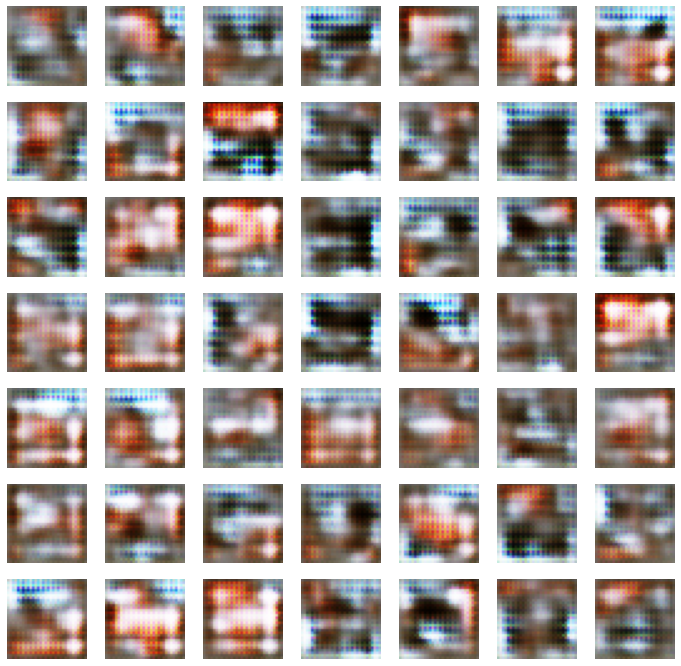

>11, 1/39, d1=0.652, d2=0.787 g=0.846
>11, 2/39, d1=0.729, d2=0.711 g=0.867
>11, 3/39, d1=0.751, d2=0.774 g=0.835
>11, 4/39, d1=0.679, d2=0.734 g=0.854
>11, 5/39, d1=0.703, d2=0.737 g=0.873
>11, 6/39, d1=0.794, d2=0.758 g=0.867
>11, 7/39, d1=0.748, d2=0.713 g=0.872
>11, 8/39, d1=0.731, d2=0.813 g=0.857
>11, 9/39, d1=0.717, d2=0.835 g=0.884
>11, 10/39, d1=0.739, d2=0.678 g=0.909
>11, 11/39, d1=0.777, d2=0.667 g=0.903
>11, 12/39, d1=0.747, d2=0.707 g=0.884
>11, 13/39, d1=0.697, d2=0.689 g=0.910
>11, 14/39, d1=0.718, d2=0.675 g=0.936
>11, 15/39, d1=0.764, d2=0.673 g=0.980
>11, 16/39, d1=0.724, d2=0.646 g=0.996
>11, 17/39, d1=0.699, d2=0.654 g=0.961
>11, 18/39, d1=0.660, d2=0.642 g=1.036
>11, 19/39, d1=0.656, d2=0.601 g=0.982
>11, 20/39, d1=0.684, d2=0.654 g=1.055
>11, 21/39, d1=0.686, d2=0.582 g=1.092
>11, 22/39, d1=0.703, d2=0.587 g=1.056
>11, 23/39, d1=0.608, d2=0.541 g=1.092
>11, 24/39, d1=0.659, d2=0.575 g=0.983
>11, 25/39, d1=0.598, d2=0.614 g=1.094
>11, 26/39, d1=0.776, d2=0.592 g=1

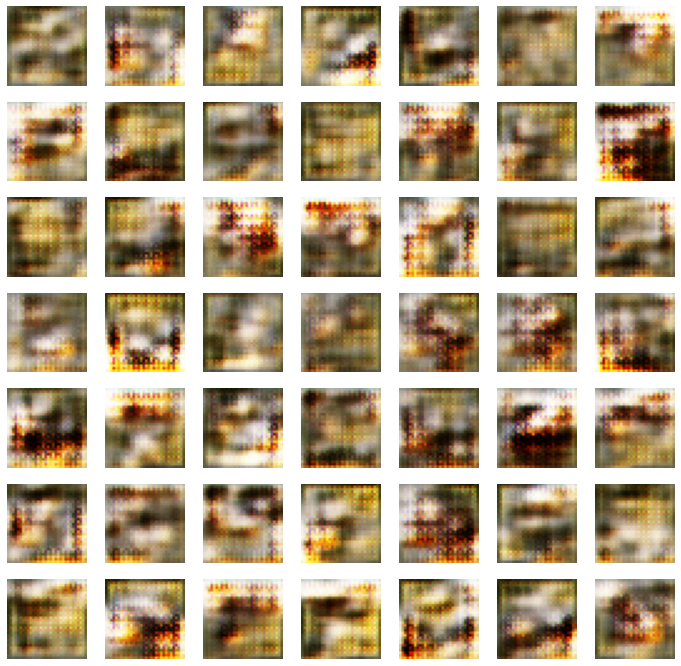

>21, 1/39, d1=0.613, d2=0.462 g=1.114
>21, 2/39, d1=0.738, d2=0.472 g=1.121
>21, 3/39, d1=0.615, d2=0.492 g=1.098
>21, 4/39, d1=0.615, d2=0.516 g=0.991
>21, 5/39, d1=0.652, d2=0.504 g=0.932
>21, 6/39, d1=0.609, d2=0.650 g=0.929
>21, 7/39, d1=0.666, d2=0.616 g=0.880
>21, 8/39, d1=0.688, d2=0.658 g=0.817
>21, 9/39, d1=0.683, d2=0.678 g=0.788
>21, 10/39, d1=0.725, d2=0.732 g=0.727
>21, 11/39, d1=0.657, d2=0.798 g=0.716
>21, 12/39, d1=0.662, d2=0.779 g=0.712
>21, 13/39, d1=0.737, d2=0.828 g=0.700
>21, 14/39, d1=0.675, d2=0.749 g=0.693
>21, 15/39, d1=0.738, d2=0.751 g=0.709
>21, 16/39, d1=0.787, d2=0.759 g=0.707
>21, 17/39, d1=0.776, d2=0.776 g=0.709
>21, 18/39, d1=0.754, d2=0.733 g=0.728
>21, 19/39, d1=0.766, d2=0.724 g=0.737
>21, 20/39, d1=0.740, d2=0.676 g=0.783
>21, 21/39, d1=0.714, d2=0.668 g=0.799
>21, 22/39, d1=0.723, d2=0.651 g=0.827
>21, 23/39, d1=0.734, d2=0.601 g=0.872
>21, 24/39, d1=0.676, d2=0.596 g=0.883
>21, 25/39, d1=0.660, d2=0.564 g=0.898
>21, 26/39, d1=0.633, d2=0.614 g=0

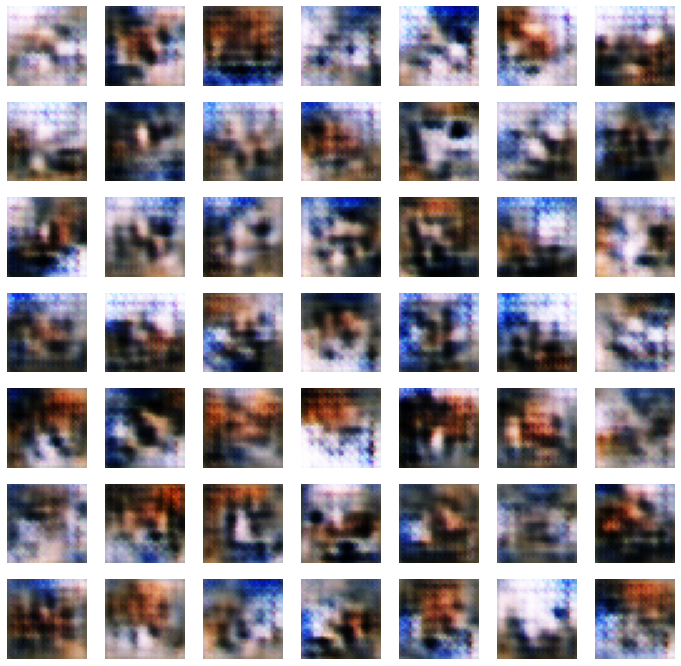

>31, 1/39, d1=0.775, d2=0.651 g=0.844
>31, 2/39, d1=0.705, d2=0.630 g=0.797
>31, 3/39, d1=0.717, d2=0.634 g=0.796
>31, 4/39, d1=0.737, d2=0.616 g=0.811
>31, 5/39, d1=0.732, d2=0.619 g=0.807
>31, 6/39, d1=0.737, d2=0.651 g=0.818
>31, 7/39, d1=0.696, d2=0.614 g=0.812
>31, 8/39, d1=0.721, d2=0.604 g=0.811
>31, 9/39, d1=0.686, d2=0.595 g=0.828
>31, 10/39, d1=0.695, d2=0.633 g=0.835
>31, 11/39, d1=0.719, d2=0.638 g=0.807
>31, 12/39, d1=0.656, d2=0.613 g=0.815
>31, 13/39, d1=0.702, d2=0.635 g=0.814
>31, 14/39, d1=0.703, d2=0.651 g=0.786
>31, 15/39, d1=0.679, d2=0.636 g=0.773
>31, 16/39, d1=0.699, d2=0.653 g=0.788
>31, 17/39, d1=0.649, d2=0.650 g=0.797
>31, 18/39, d1=0.652, d2=0.663 g=0.774
>31, 19/39, d1=0.658, d2=0.664 g=0.792
>31, 20/39, d1=0.670, d2=0.648 g=0.778
>31, 21/39, d1=0.663, d2=0.661 g=0.768
>31, 22/39, d1=0.682, d2=0.683 g=0.770
>31, 23/39, d1=0.637, d2=0.648 g=0.782
>31, 24/39, d1=0.642, d2=0.665 g=0.787
>31, 25/39, d1=0.654, d2=0.658 g=0.785
>31, 26/39, d1=0.658, d2=0.638 g=0

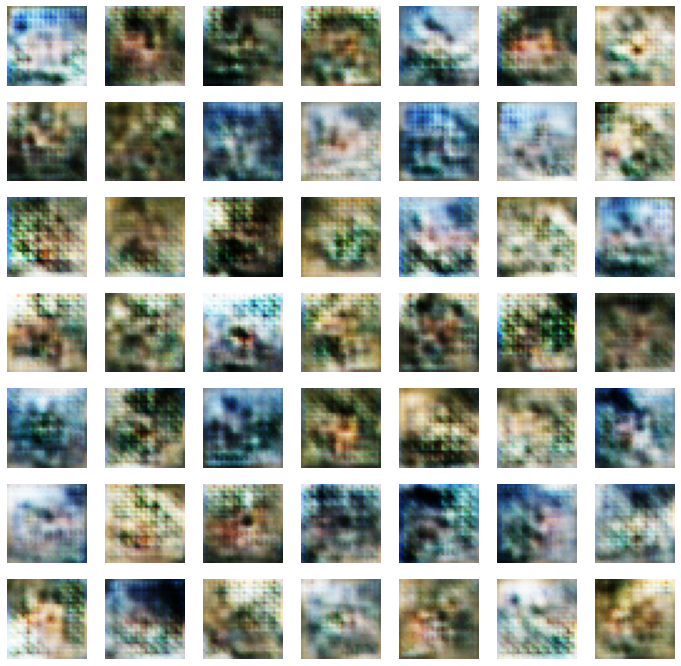

>41, 1/39, d1=0.652, d2=0.704 g=0.726
>41, 2/39, d1=0.672, d2=0.700 g=0.735
>41, 3/39, d1=0.656, d2=0.664 g=0.733
>41, 4/39, d1=0.677, d2=0.680 g=0.722
>41, 5/39, d1=0.686, d2=0.683 g=0.714
>41, 6/39, d1=0.667, d2=0.705 g=0.721
>41, 7/39, d1=0.693, d2=0.708 g=0.718
>41, 8/39, d1=0.690, d2=0.703 g=0.699
>41, 9/39, d1=0.633, d2=0.712 g=0.705
>41, 10/39, d1=0.668, d2=0.704 g=0.712
>41, 11/39, d1=0.708, d2=0.725 g=0.711
>41, 12/39, d1=0.679, d2=0.704 g=0.714
>41, 13/39, d1=0.682, d2=0.708 g=0.715
>41, 14/39, d1=0.691, d2=0.708 g=0.708
>41, 15/39, d1=0.701, d2=0.698 g=0.713
>41, 16/39, d1=0.682, d2=0.724 g=0.705
>41, 17/39, d1=0.672, d2=0.720 g=0.702
>41, 18/39, d1=0.699, d2=0.709 g=0.700
>41, 19/39, d1=0.691, d2=0.720 g=0.707
>41, 20/39, d1=0.690, d2=0.709 g=0.729
>41, 21/39, d1=0.705, d2=0.686 g=0.746
>41, 22/39, d1=0.720, d2=0.685 g=0.749
>41, 23/39, d1=0.724, d2=0.677 g=0.752
>41, 24/39, d1=0.717, d2=0.677 g=0.757
>41, 25/39, d1=0.720, d2=0.660 g=0.764
>41, 26/39, d1=0.695, d2=0.666 g=0

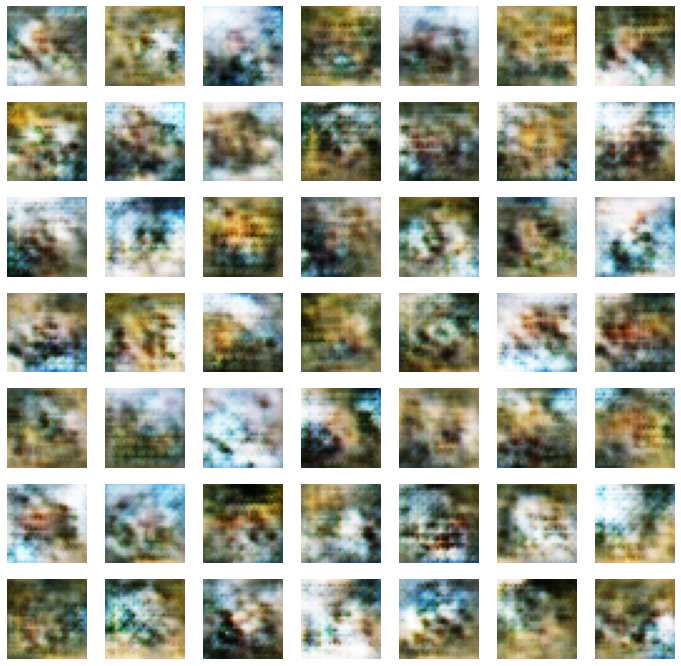

>51, 1/39, d1=0.630, d2=0.726 g=0.706
>51, 2/39, d1=0.647, d2=0.739 g=0.681
>51, 3/39, d1=0.636, d2=0.726 g=0.681
>51, 4/39, d1=0.619, d2=0.734 g=0.697
>51, 5/39, d1=0.642, d2=0.734 g=0.700
>51, 6/39, d1=0.652, d2=0.715 g=0.709
>51, 7/39, d1=0.669, d2=0.724 g=0.716
>51, 8/39, d1=0.679, d2=0.711 g=0.724
>51, 9/39, d1=0.654, d2=0.705 g=0.735
>51, 10/39, d1=0.702, d2=0.700 g=0.760
>51, 11/39, d1=0.715, d2=0.685 g=0.760
>51, 12/39, d1=0.717, d2=0.676 g=0.743
>51, 13/39, d1=0.719, d2=0.686 g=0.734
>51, 14/39, d1=0.731, d2=0.675 g=0.757
>51, 15/39, d1=0.714, d2=0.698 g=0.755
>51, 16/39, d1=0.699, d2=0.702 g=0.744
>51, 17/39, d1=0.738, d2=0.707 g=0.763
>51, 18/39, d1=0.733, d2=0.678 g=0.770
>51, 19/39, d1=0.753, d2=0.671 g=0.772
>51, 20/39, d1=0.729, d2=0.639 g=0.796
>51, 21/39, d1=0.721, d2=0.636 g=0.789
>51, 22/39, d1=0.715, d2=0.639 g=0.818
>51, 23/39, d1=0.722, d2=0.616 g=0.822
>51, 24/39, d1=0.729, d2=0.640 g=0.792
>51, 25/39, d1=0.715, d2=0.648 g=0.779
>51, 26/39, d1=0.706, d2=0.670 g=0

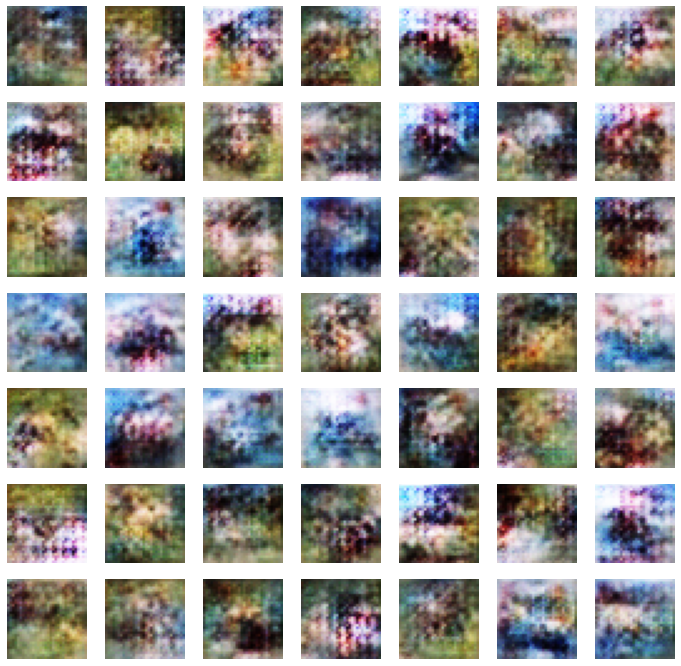

>61, 1/39, d1=0.673, d2=0.658 g=0.767
>61, 2/39, d1=0.678, d2=0.647 g=0.748
>61, 3/39, d1=0.682, d2=0.675 g=0.746
>61, 4/39, d1=0.679, d2=0.703 g=0.744
>61, 5/39, d1=0.699, d2=0.681 g=0.767
>61, 6/39, d1=0.695, d2=0.668 g=0.789
>61, 7/39, d1=0.675, d2=0.645 g=0.814
>61, 8/39, d1=0.688, d2=0.632 g=0.832
>61, 9/39, d1=0.693, d2=0.628 g=0.818
>61, 10/39, d1=0.683, d2=0.658 g=0.794
>61, 11/39, d1=0.686, d2=0.652 g=0.781
>61, 12/39, d1=0.702, d2=0.675 g=0.745
>61, 13/39, d1=0.667, d2=0.693 g=0.726
>61, 14/39, d1=0.682, d2=0.708 g=0.723
>61, 15/39, d1=0.689, d2=0.699 g=0.721
>61, 16/39, d1=0.663, d2=0.712 g=0.724
>61, 17/39, d1=0.691, d2=0.707 g=0.744
>61, 18/39, d1=0.693, d2=0.671 g=0.769
>61, 19/39, d1=0.684, d2=0.649 g=0.801
>61, 20/39, d1=0.706, d2=0.611 g=0.825
>61, 21/39, d1=0.688, d2=0.605 g=0.836
>61, 22/39, d1=0.715, d2=0.615 g=0.813
>61, 23/39, d1=0.710, d2=0.601 g=0.805
>61, 24/39, d1=0.668, d2=0.666 g=0.772
>61, 25/39, d1=0.678, d2=0.685 g=0.743
>61, 26/39, d1=0.691, d2=0.701 g=0

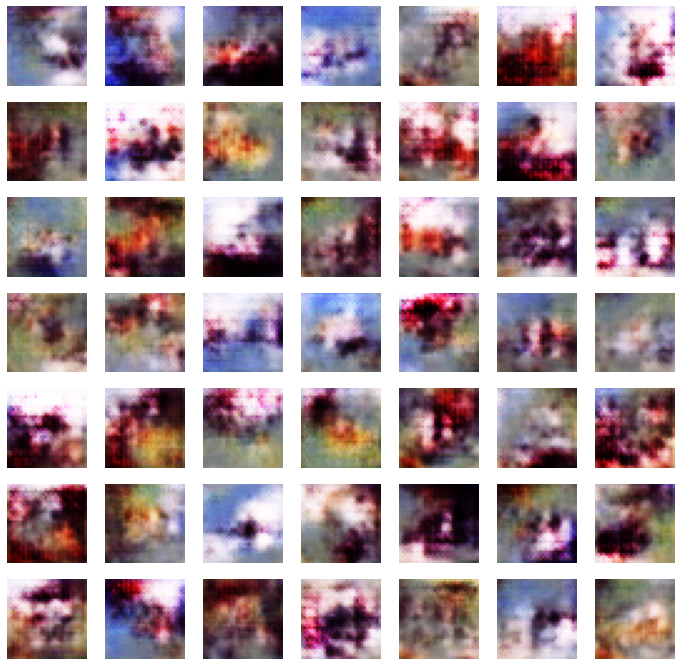

>71, 1/39, d1=0.645, d2=0.591 g=0.863
>71, 2/39, d1=0.621, d2=0.613 g=0.818
>71, 3/39, d1=0.660, d2=0.638 g=0.805
>71, 4/39, d1=0.655, d2=0.675 g=0.737
>71, 5/39, d1=0.616, d2=0.742 g=0.724
>71, 6/39, d1=0.634, d2=0.764 g=0.691
>71, 7/39, d1=0.673, d2=0.752 g=0.674
>71, 8/39, d1=0.635, d2=0.808 g=0.673
>71, 9/39, d1=0.698, d2=0.742 g=0.698
>71, 10/39, d1=0.684, d2=0.706 g=0.808
>71, 11/39, d1=0.718, d2=0.669 g=0.807
>71, 12/39, d1=0.705, d2=0.654 g=0.834
>71, 13/39, d1=0.697, d2=0.633 g=0.880
>71, 14/39, d1=0.681, d2=0.590 g=0.897
>71, 15/39, d1=0.700, d2=0.616 g=0.864
>71, 16/39, d1=0.667, d2=0.621 g=0.857
>71, 17/39, d1=0.683, d2=0.642 g=0.803
>71, 18/39, d1=0.672, d2=0.679 g=0.793
>71, 19/39, d1=0.672, d2=0.666 g=0.754
>71, 20/39, d1=0.677, d2=0.656 g=0.766
>71, 21/39, d1=0.695, d2=0.671 g=0.742
>71, 22/39, d1=0.683, d2=0.706 g=0.726
>71, 23/39, d1=0.675, d2=0.711 g=0.703
>71, 24/39, d1=0.669, d2=0.729 g=0.698
>71, 25/39, d1=0.704, d2=0.710 g=0.733
>71, 26/39, d1=0.690, d2=0.718 g=0

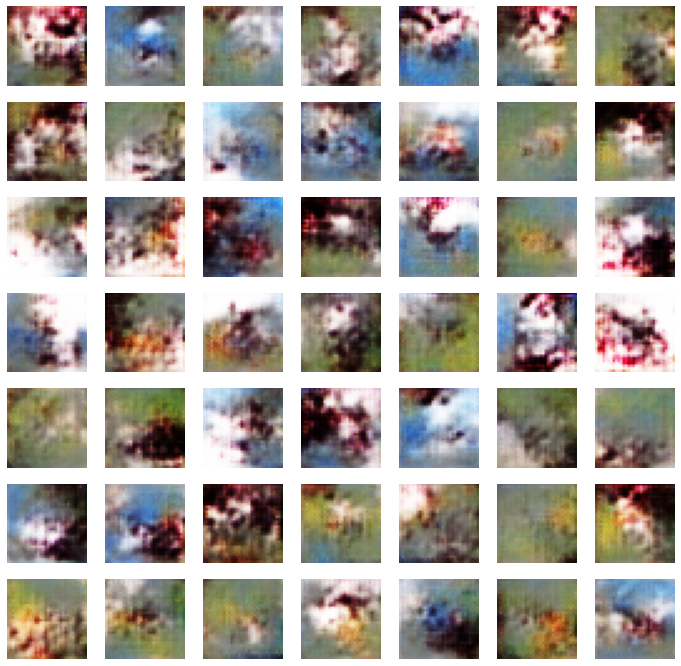

>81, 1/39, d1=0.679, d2=0.735 g=0.757
>81, 2/39, d1=0.643, d2=0.734 g=0.766
>81, 3/39, d1=0.671, d2=0.730 g=0.741
>81, 4/39, d1=0.681, d2=0.716 g=0.709
>81, 5/39, d1=0.674, d2=0.727 g=0.714
>81, 6/39, d1=0.659, d2=0.759 g=0.687
>81, 7/39, d1=0.677, d2=0.721 g=0.739
>81, 8/39, d1=0.675, d2=0.719 g=0.729
>81, 9/39, d1=0.656, d2=0.733 g=0.735
>81, 10/39, d1=0.705, d2=0.704 g=0.744
>81, 11/39, d1=0.674, d2=0.710 g=0.715
>81, 12/39, d1=0.705, d2=0.758 g=0.742
>81, 13/39, d1=0.666, d2=0.726 g=0.777
>81, 14/39, d1=0.726, d2=0.705 g=0.794
>81, 15/39, d1=0.740, d2=0.664 g=0.766
>81, 16/39, d1=0.734, d2=0.644 g=0.775
>81, 17/39, d1=0.736, d2=0.649 g=0.798
>81, 18/39, d1=0.699, d2=0.633 g=0.832
>81, 19/39, d1=0.714, d2=0.638 g=0.813
>81, 20/39, d1=0.685, d2=0.615 g=0.834
>81, 21/39, d1=0.701, d2=0.616 g=0.819
>81, 22/39, d1=0.668, d2=0.633 g=0.804
>81, 23/39, d1=0.692, d2=0.622 g=0.789
>81, 24/39, d1=0.713, d2=0.644 g=0.799
>81, 25/39, d1=0.718, d2=0.660 g=0.816
>81, 26/39, d1=0.693, d2=0.663 g=0

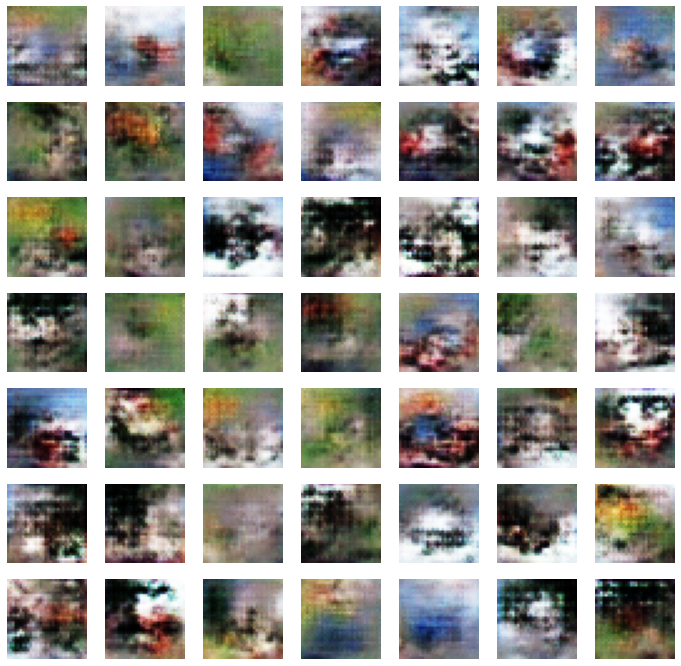

>91, 1/39, d1=0.663, d2=0.657 g=0.765
>91, 2/39, d1=0.643, d2=0.648 g=0.789
>91, 3/39, d1=0.594, d2=0.671 g=0.780
>91, 4/39, d1=0.621, d2=0.658 g=0.764
>91, 5/39, d1=0.628, d2=0.676 g=0.726
>91, 6/39, d1=0.641, d2=0.707 g=0.718
>91, 7/39, d1=0.611, d2=0.708 g=0.732
>91, 8/39, d1=0.657, d2=0.738 g=0.722
>91, 9/39, d1=0.666, d2=0.690 g=0.756
>91, 10/39, d1=0.650, d2=0.713 g=0.763
>91, 11/39, d1=0.611, d2=0.684 g=0.749
>91, 12/39, d1=0.701, d2=0.690 g=0.799
>91, 13/39, d1=0.694, d2=0.656 g=0.787
>91, 14/39, d1=0.685, d2=0.673 g=0.748
>91, 15/39, d1=0.717, d2=0.675 g=0.757
>91, 16/39, d1=0.694, d2=0.676 g=0.786
>91, 17/39, d1=0.689, d2=0.675 g=0.807
>91, 18/39, d1=0.639, d2=0.633 g=0.859
>91, 19/39, d1=0.663, d2=0.616 g=0.873
>91, 20/39, d1=0.673, d2=0.646 g=0.845
>91, 21/39, d1=0.680, d2=0.605 g=0.848
>91, 22/39, d1=0.698, d2=0.673 g=0.769
>91, 23/39, d1=0.663, d2=0.701 g=0.764
>91, 24/39, d1=0.709, d2=0.724 g=0.789
>91, 25/39, d1=0.735, d2=0.666 g=0.802
>91, 26/39, d1=0.751, d2=0.638 g=0

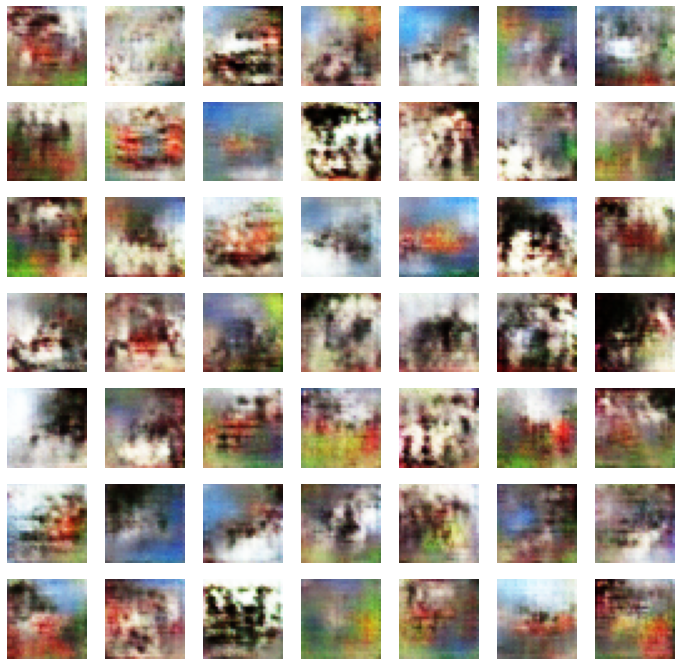

>101, 1/39, d1=0.688, d2=0.652 g=0.786
>101, 2/39, d1=0.703, d2=0.649 g=0.834
>101, 3/39, d1=0.680, d2=0.624 g=0.845
>101, 4/39, d1=0.733, d2=0.654 g=0.805
>101, 5/39, d1=0.691, d2=0.650 g=0.750
>101, 6/39, d1=0.680, d2=0.693 g=0.748
>101, 7/39, d1=0.702, d2=0.710 g=0.745
>101, 8/39, d1=0.673, d2=0.713 g=0.754
>101, 9/39, d1=0.704, d2=0.677 g=0.807
>101, 10/39, d1=0.695, d2=0.670 g=0.803
>101, 11/39, d1=0.734, d2=0.628 g=0.841
>101, 12/39, d1=0.712, d2=0.637 g=0.815
>101, 13/39, d1=0.697, d2=0.626 g=0.779
>101, 14/39, d1=0.750, d2=0.664 g=0.730
>101, 15/39, d1=0.672, d2=0.694 g=0.729
>101, 16/39, d1=0.680, d2=0.705 g=0.742
>101, 17/39, d1=0.683, d2=0.690 g=0.781
>101, 18/39, d1=0.685, d2=0.638 g=0.875
>101, 19/39, d1=0.650, d2=0.582 g=0.930
>101, 20/39, d1=0.732, d2=0.628 g=0.874
>101, 21/39, d1=0.685, d2=0.683 g=0.750
>101, 22/39, d1=0.667, d2=0.716 g=0.728
>101, 23/39, d1=0.668, d2=0.799 g=0.726
>101, 24/39, d1=0.724, d2=0.701 g=0.789
>101, 25/39, d1=0.700, d2=0.616 g=0.839
>101, 26/

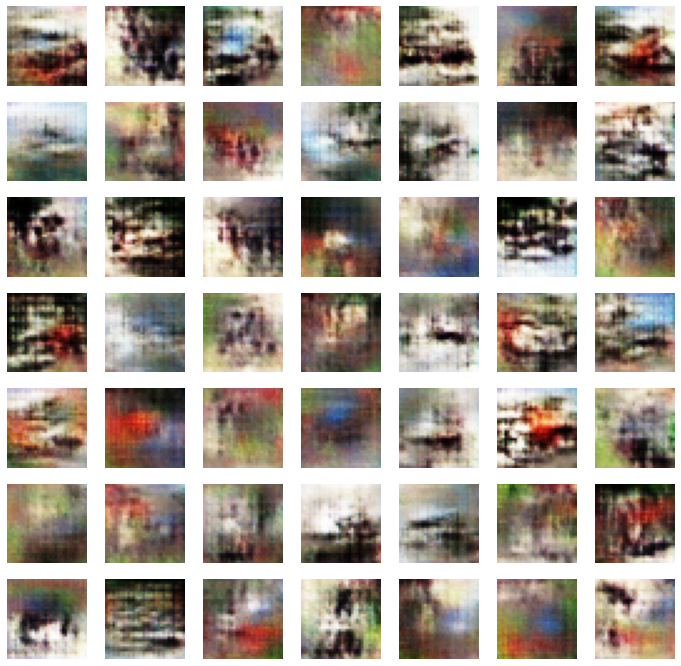

>111, 1/39, d1=0.648, d2=0.749 g=0.691
>111, 2/39, d1=0.732, d2=0.758 g=0.718
>111, 3/39, d1=0.647, d2=0.693 g=0.755
>111, 4/39, d1=0.662, d2=0.648 g=0.783
>111, 5/39, d1=0.650, d2=0.623 g=0.835
>111, 6/39, d1=0.638, d2=0.599 g=0.857
>111, 7/39, d1=0.670, d2=0.589 g=0.838
>111, 8/39, d1=0.781, d2=0.568 g=0.858
>111, 9/39, d1=0.637, d2=0.643 g=0.842
>111, 10/39, d1=0.611, d2=0.607 g=0.832
>111, 11/39, d1=0.656, d2=0.689 g=0.780
>111, 12/39, d1=0.706, d2=0.744 g=0.721
>111, 13/39, d1=0.663, d2=0.767 g=0.703
>111, 14/39, d1=0.669, d2=0.781 g=0.670
>111, 15/39, d1=0.655, d2=0.755 g=0.702
>111, 16/39, d1=0.659, d2=0.704 g=0.739
>111, 17/39, d1=0.660, d2=0.685 g=0.779
>111, 18/39, d1=0.667, d2=0.664 g=0.783
>111, 19/39, d1=0.679, d2=0.639 g=0.796
>111, 20/39, d1=0.664, d2=0.629 g=0.802
>111, 21/39, d1=0.674, d2=0.661 g=0.793
>111, 22/39, d1=0.661, d2=0.664 g=0.764
>111, 23/39, d1=0.688, d2=0.689 g=0.721
>111, 24/39, d1=0.695, d2=0.701 g=0.720
>111, 25/39, d1=0.662, d2=0.730 g=0.706
>111, 26/

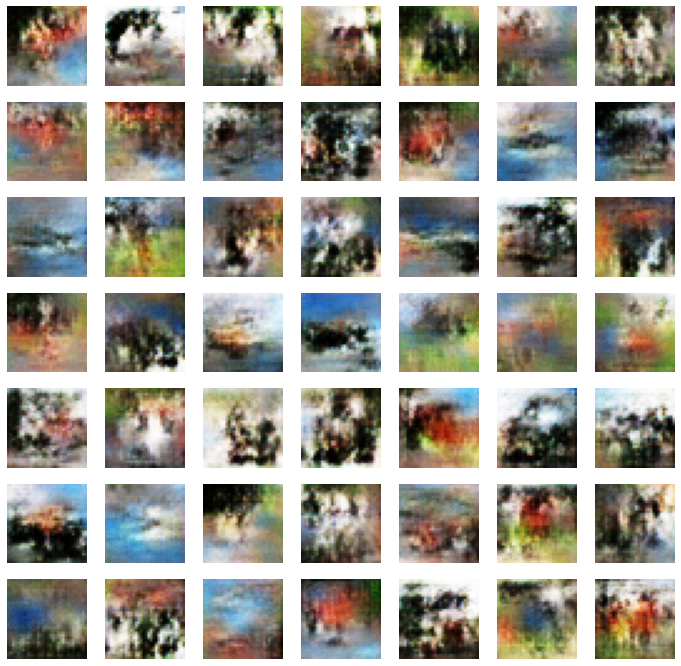

>121, 1/39, d1=0.669, d2=0.688 g=0.773
>121, 2/39, d1=0.683, d2=0.674 g=0.761
>121, 3/39, d1=0.694, d2=0.697 g=0.761
>121, 4/39, d1=0.672, d2=0.663 g=0.755
>121, 5/39, d1=0.686, d2=0.686 g=0.748
>121, 6/39, d1=0.689, d2=0.677 g=0.773
>121, 7/39, d1=0.686, d2=0.669 g=0.750
>121, 8/39, d1=0.680, d2=0.696 g=0.746
>121, 9/39, d1=0.667, d2=0.708 g=0.740
>121, 10/39, d1=0.676, d2=0.706 g=0.712
>121, 11/39, d1=0.676, d2=0.710 g=0.723
>121, 12/39, d1=0.684, d2=0.717 g=0.712
>121, 13/39, d1=0.680, d2=0.697 g=0.721
>121, 14/39, d1=0.669, d2=0.699 g=0.729
>121, 15/39, d1=0.669, d2=0.665 g=0.763
>121, 16/39, d1=0.669, d2=0.632 g=0.789
>121, 17/39, d1=0.673, d2=0.670 g=0.785
>121, 18/39, d1=0.727, d2=0.653 g=0.769
>121, 19/39, d1=0.681, d2=0.698 g=0.733
>121, 20/39, d1=0.675, d2=0.692 g=0.726
>121, 21/39, d1=0.662, d2=0.687 g=0.755
>121, 22/39, d1=0.678, d2=0.653 g=0.791
>121, 23/39, d1=0.701, d2=0.652 g=0.832
>121, 24/39, d1=0.669, d2=0.632 g=0.822
>121, 25/39, d1=0.671, d2=0.658 g=0.764
>121, 26/

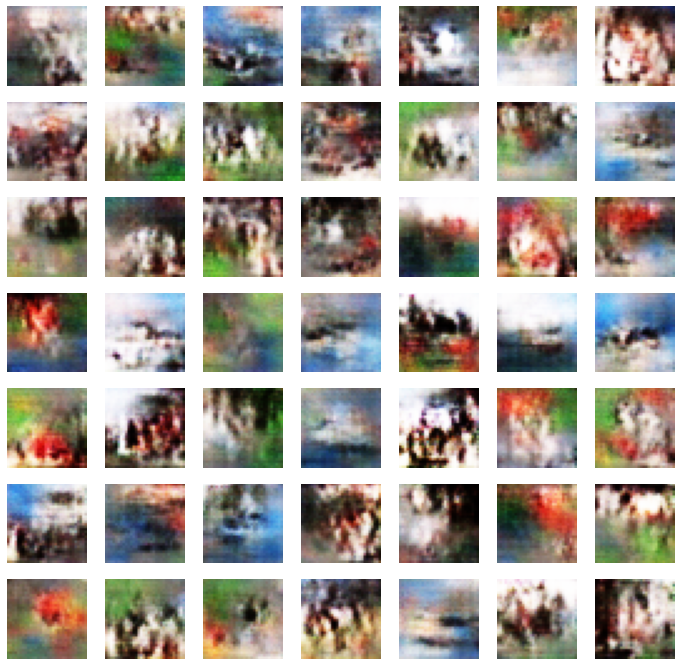

>131, 1/39, d1=0.693, d2=0.703 g=0.767
>131, 2/39, d1=0.721, d2=0.683 g=0.784
>131, 3/39, d1=0.699, d2=0.642 g=0.790
>131, 4/39, d1=0.730, d2=0.649 g=0.780
>131, 5/39, d1=0.704, d2=0.671 g=0.774
>131, 6/39, d1=0.674, d2=0.661 g=0.753
>131, 7/39, d1=0.707, d2=0.703 g=0.759
>131, 8/39, d1=0.718, d2=0.701 g=0.750
>131, 9/39, d1=0.713, d2=0.699 g=0.763
>131, 10/39, d1=0.709, d2=0.671 g=0.789
>131, 11/39, d1=0.699, d2=0.653 g=0.813
>131, 12/39, d1=0.694, d2=0.626 g=0.874
>131, 13/39, d1=0.746, d2=0.579 g=0.867
>131, 14/39, d1=0.757, d2=0.575 g=0.879
>131, 15/39, d1=0.732, d2=0.598 g=0.885
>131, 16/39, d1=0.721, d2=0.607 g=0.861
>131, 17/39, d1=0.696, d2=0.634 g=0.812
>131, 18/39, d1=0.693, d2=0.651 g=0.783
>131, 19/39, d1=0.685, d2=0.678 g=0.774
>131, 20/39, d1=0.683, d2=0.665 g=0.766
>131, 21/39, d1=0.687, d2=0.664 g=0.741
>131, 22/39, d1=0.675, d2=0.700 g=0.736
>131, 23/39, d1=0.698, d2=0.703 g=0.748
>131, 24/39, d1=0.688, d2=0.700 g=0.727
>131, 25/39, d1=0.701, d2=0.687 g=0.748
>131, 26/

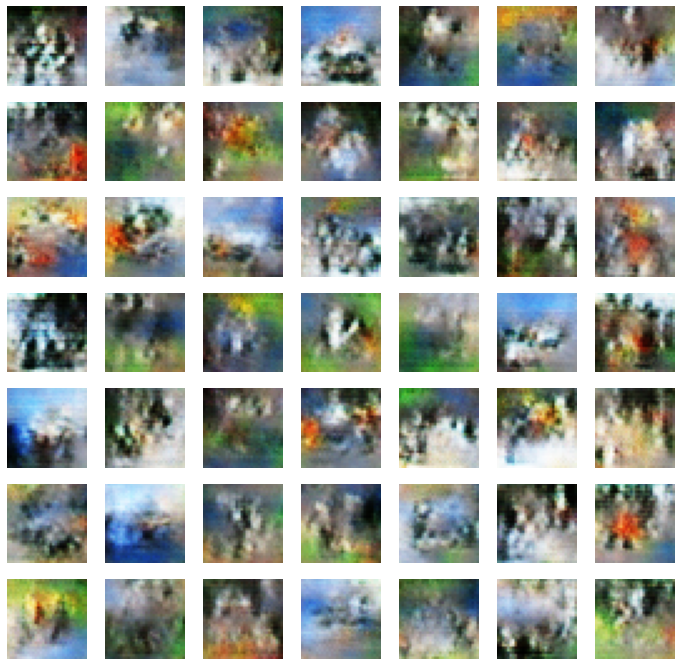

>141, 1/39, d1=0.689, d2=0.711 g=0.767
>141, 2/39, d1=0.677, d2=0.687 g=0.728
>141, 3/39, d1=0.692, d2=0.706 g=0.719
>141, 4/39, d1=0.708, d2=0.712 g=0.711
>141, 5/39, d1=0.688, d2=0.730 g=0.711
>141, 6/39, d1=0.685, d2=0.722 g=0.711
>141, 7/39, d1=0.659, d2=0.779 g=0.699
>141, 8/39, d1=0.663, d2=0.734 g=0.724
>141, 9/39, d1=0.667, d2=0.722 g=0.731
>141, 10/39, d1=0.647, d2=0.674 g=0.770
>141, 11/39, d1=0.686, d2=0.664 g=0.800
>141, 12/39, d1=0.635, d2=0.615 g=0.804
>141, 13/39, d1=0.671, d2=0.623 g=0.828
>141, 14/39, d1=0.615, d2=0.600 g=0.861
>141, 15/39, d1=0.613, d2=0.590 g=0.843
>141, 16/39, d1=0.629, d2=0.626 g=0.823
>141, 17/39, d1=0.617, d2=0.665 g=0.806
>141, 18/39, d1=0.650, d2=0.668 g=0.785
>141, 19/39, d1=0.641, d2=0.696 g=0.768
>141, 20/39, d1=0.610, d2=0.689 g=0.775
>141, 21/39, d1=0.662, d2=0.660 g=0.750
>141, 22/39, d1=0.645, d2=0.667 g=0.804
>141, 23/39, d1=0.646, d2=0.650 g=0.818
>141, 24/39, d1=0.616, d2=0.653 g=0.837
>141, 25/39, d1=0.679, d2=0.615 g=0.865
>141, 26/

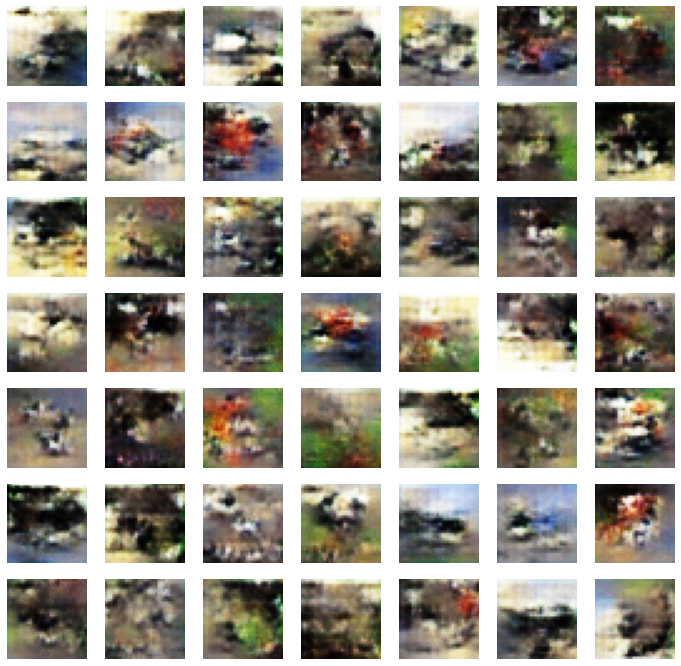

>151, 1/39, d1=0.686, d2=0.666 g=0.788
>151, 2/39, d1=0.730, d2=0.675 g=0.777
>151, 3/39, d1=0.706, d2=0.682 g=0.804
>151, 4/39, d1=0.710, d2=0.674 g=0.798
>151, 5/39, d1=0.707, d2=0.719 g=0.785
>151, 6/39, d1=0.686, d2=0.648 g=0.774
>151, 7/39, d1=0.731, d2=0.706 g=0.791
>151, 8/39, d1=0.694, d2=0.691 g=0.795
>151, 9/39, d1=0.732, d2=0.661 g=0.799
>151, 10/39, d1=0.701, d2=0.637 g=0.842
>151, 11/39, d1=0.723, d2=0.633 g=0.849
>151, 12/39, d1=0.691, d2=0.609 g=0.865
>151, 13/39, d1=0.684, d2=0.613 g=0.873
>151, 14/39, d1=0.724, d2=0.648 g=0.869
>151, 15/39, d1=0.679, d2=0.619 g=0.840
>151, 16/39, d1=0.697, d2=0.620 g=0.855
>151, 17/39, d1=0.720, d2=0.655 g=0.838
>151, 18/39, d1=0.686, d2=0.645 g=0.819
>151, 19/39, d1=0.679, d2=0.661 g=0.817
>151, 20/39, d1=0.611, d2=0.654 g=0.835
>151, 21/39, d1=0.644, d2=0.654 g=0.800
>151, 22/39, d1=0.676, d2=0.686 g=0.795
>151, 23/39, d1=0.683, d2=0.641 g=0.800
>151, 24/39, d1=0.684, d2=0.671 g=0.800
>151, 25/39, d1=0.663, d2=0.665 g=0.759
>151, 26/

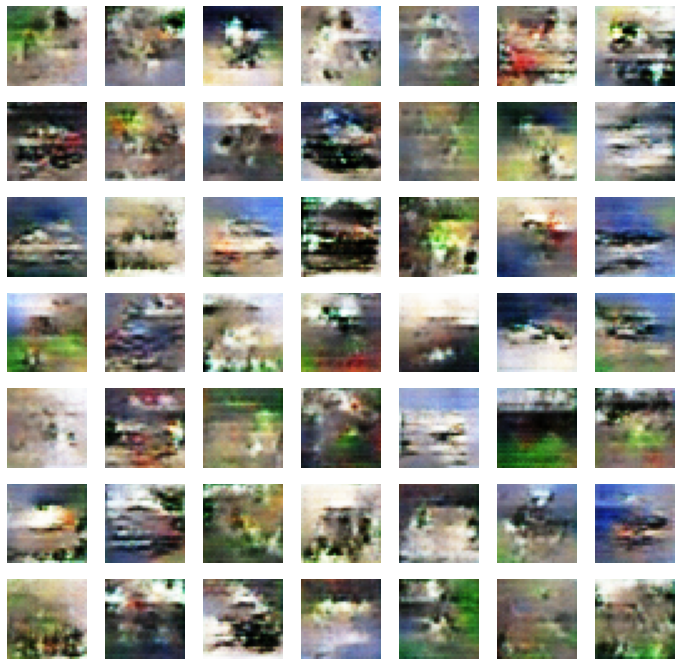

>161, 1/39, d1=0.692, d2=0.586 g=0.874
>161, 2/39, d1=0.660, d2=0.587 g=0.894
>161, 3/39, d1=0.668, d2=0.636 g=0.855
>161, 4/39, d1=0.666, d2=0.650 g=0.787
>161, 5/39, d1=0.635, d2=0.726 g=0.764
>161, 6/39, d1=0.652, d2=0.707 g=0.741
>161, 7/39, d1=0.692, d2=0.717 g=0.802
>161, 8/39, d1=0.702, d2=0.679 g=0.875
>161, 9/39, d1=0.653, d2=0.615 g=0.891
>161, 10/39, d1=0.708, d2=0.611 g=0.885
>161, 11/39, d1=0.682, d2=0.639 g=0.829
>161, 12/39, d1=0.645, d2=0.683 g=0.789
>161, 13/39, d1=0.696, d2=0.698 g=0.772
>161, 14/39, d1=0.689, d2=0.748 g=0.744
>161, 15/39, d1=0.662, d2=0.719 g=0.773
>161, 16/39, d1=0.657, d2=0.706 g=0.783
>161, 17/39, d1=0.683, d2=0.663 g=0.782
>161, 18/39, d1=0.659, d2=0.702 g=0.801
>161, 19/39, d1=0.643, d2=0.684 g=0.797
>161, 20/39, d1=0.680, d2=0.698 g=0.796
>161, 21/39, d1=0.700, d2=0.668 g=0.817
>161, 22/39, d1=0.694, d2=0.651 g=0.813
>161, 23/39, d1=0.694, d2=0.670 g=0.785
>161, 24/39, d1=0.690, d2=0.722 g=0.828
>161, 25/39, d1=0.700, d2=0.677 g=0.776
>161, 26/

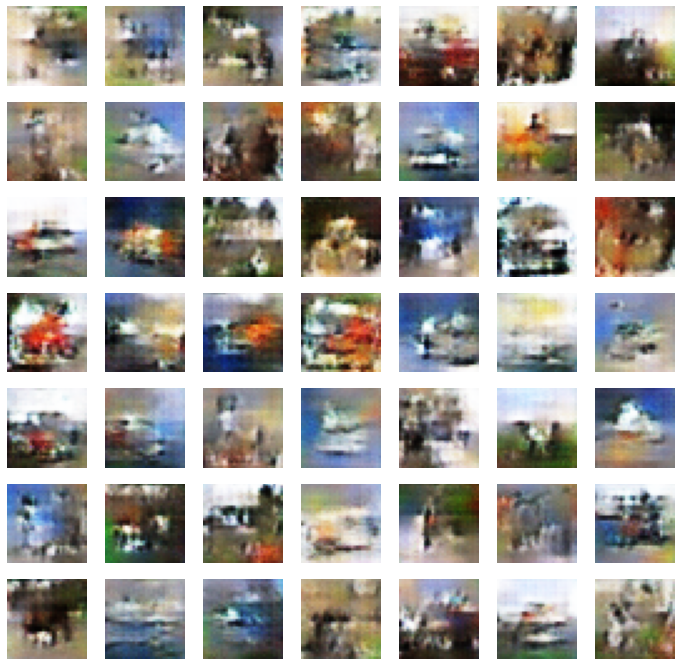

>171, 1/39, d1=0.700, d2=0.662 g=0.767
>171, 2/39, d1=0.669, d2=0.696 g=0.775
>171, 3/39, d1=0.686, d2=0.661 g=0.796
>171, 4/39, d1=0.704, d2=0.697 g=0.794
>171, 5/39, d1=0.675, d2=0.691 g=0.783
>171, 6/39, d1=0.696, d2=0.636 g=0.798
>171, 7/39, d1=0.694, d2=0.640 g=0.842
>171, 8/39, d1=0.693, d2=0.659 g=0.839
>171, 9/39, d1=0.670, d2=0.655 g=0.841
>171, 10/39, d1=0.707, d2=0.614 g=0.849
>171, 11/39, d1=0.682, d2=0.626 g=0.825
>171, 12/39, d1=0.636, d2=0.678 g=0.778
>171, 13/39, d1=0.661, d2=0.662 g=0.740
>171, 14/39, d1=0.629, d2=0.722 g=0.743
>171, 15/39, d1=0.699, d2=0.783 g=0.770
>171, 16/39, d1=0.663, d2=0.771 g=0.737
>171, 17/39, d1=0.703, d2=0.697 g=0.773
>171, 18/39, d1=0.703, d2=0.682 g=0.786
>171, 19/39, d1=0.652, d2=0.640 g=0.822
>171, 20/39, d1=0.685, d2=0.626 g=0.844
>171, 21/39, d1=0.710, d2=0.644 g=0.820
>171, 22/39, d1=0.690, d2=0.652 g=0.840
>171, 23/39, d1=0.659, d2=0.666 g=0.782
>171, 24/39, d1=0.660, d2=0.648 g=0.783
>171, 25/39, d1=0.703, d2=0.672 g=0.772
>171, 26/

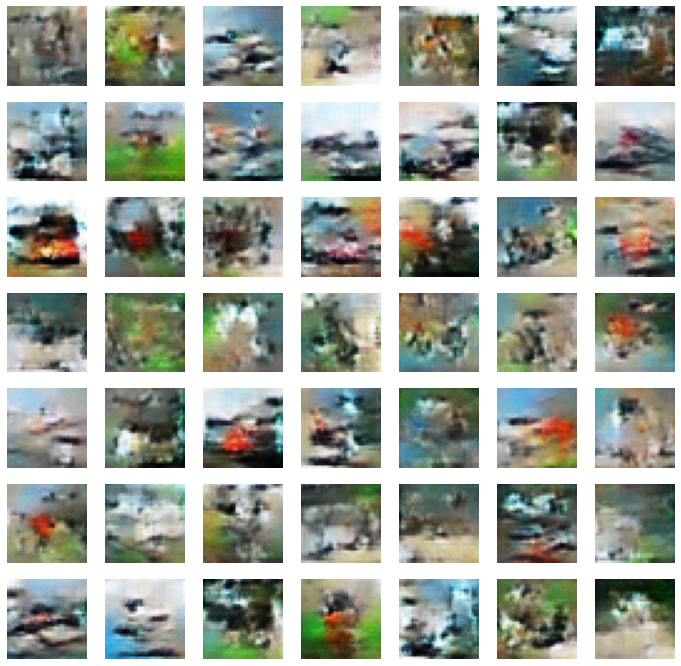

>181, 1/39, d1=0.700, d2=0.665 g=0.800
>181, 2/39, d1=0.697, d2=0.673 g=0.755
>181, 3/39, d1=0.713, d2=0.694 g=0.778
>181, 4/39, d1=0.719, d2=0.711 g=0.785
>181, 5/39, d1=0.711, d2=0.692 g=0.745
>181, 6/39, d1=0.718, d2=0.728 g=0.748
>181, 7/39, d1=0.679, d2=0.701 g=0.772
>181, 8/39, d1=0.752, d2=0.664 g=0.769
>181, 9/39, d1=0.692, d2=0.660 g=0.751
>181, 10/39, d1=0.740, d2=0.672 g=0.793
>181, 11/39, d1=0.698, d2=0.644 g=0.794
>181, 12/39, d1=0.674, d2=0.619 g=0.829
>181, 13/39, d1=0.661, d2=0.668 g=0.830
>181, 14/39, d1=0.658, d2=0.641 g=0.799
>181, 15/39, d1=0.689, d2=0.681 g=0.787
>181, 16/39, d1=0.710, d2=0.676 g=0.746
>181, 17/39, d1=0.655, d2=0.706 g=0.690
>181, 18/39, d1=0.624, d2=0.748 g=0.703
>181, 19/39, d1=0.684, d2=0.727 g=0.716
>181, 20/39, d1=0.671, d2=0.724 g=0.722
>181, 21/39, d1=0.685, d2=0.668 g=0.750
>181, 22/39, d1=0.674, d2=0.677 g=0.762
>181, 23/39, d1=0.653, d2=0.678 g=0.761
>181, 24/39, d1=0.670, d2=0.708 g=0.768
>181, 25/39, d1=0.695, d2=0.673 g=0.769
>181, 26/

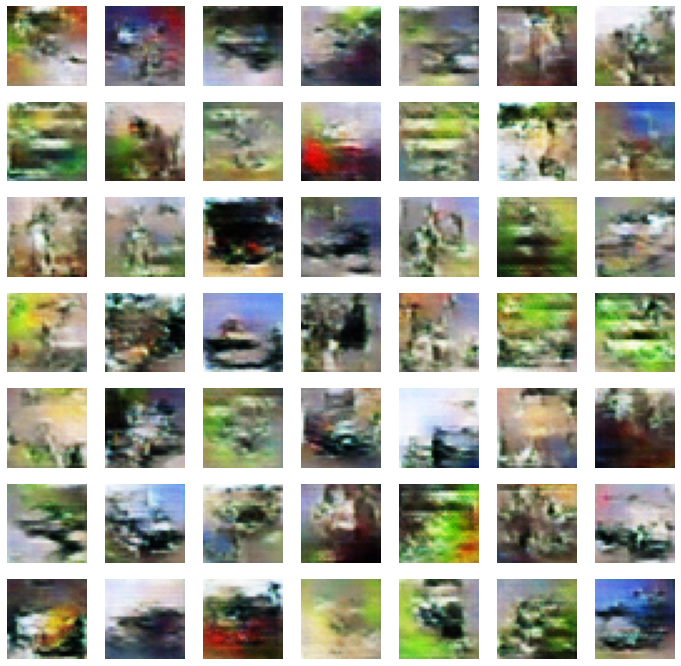

>191, 1/39, d1=0.719, d2=0.678 g=0.750
>191, 2/39, d1=0.709, d2=0.725 g=0.732
>191, 3/39, d1=0.684, d2=0.697 g=0.754
>191, 4/39, d1=0.679, d2=0.686 g=0.776
>191, 5/39, d1=0.691, d2=0.673 g=0.799
>191, 6/39, d1=0.682, d2=0.663 g=0.814
>191, 7/39, d1=0.675, d2=0.677 g=0.798
>191, 8/39, d1=0.670, d2=0.631 g=0.831
>191, 9/39, d1=0.698, d2=0.631 g=0.817
>191, 10/39, d1=0.663, d2=0.647 g=0.831
>191, 11/39, d1=0.699, d2=0.697 g=0.788
>191, 12/39, d1=0.665, d2=0.652 g=0.779
>191, 13/39, d1=0.672, d2=0.686 g=0.777
>191, 14/39, d1=0.690, d2=0.669 g=0.800
>191, 15/39, d1=0.695, d2=0.669 g=0.806
>191, 16/39, d1=0.699, d2=0.636 g=0.837
>191, 17/39, d1=0.714, d2=0.663 g=0.868
>191, 18/39, d1=0.748, d2=0.631 g=0.884
>191, 19/39, d1=0.722, d2=0.607 g=0.871
>191, 20/39, d1=0.757, d2=0.615 g=0.840
>191, 21/39, d1=0.753, d2=0.671 g=0.830
>191, 22/39, d1=0.688, d2=0.642 g=0.839
>191, 23/39, d1=0.721, d2=0.695 g=0.795
>191, 24/39, d1=0.722, d2=0.680 g=0.768
>191, 25/39, d1=0.733, d2=0.687 g=0.753
>191, 26/

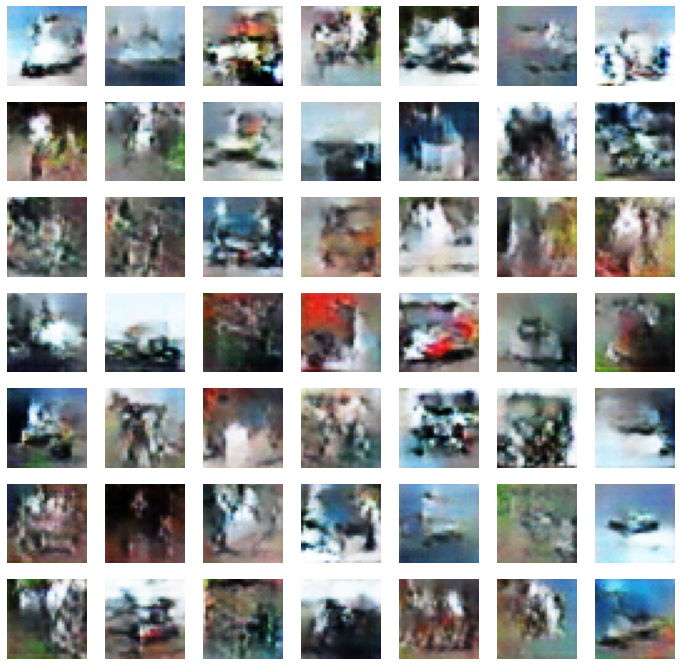

>201, 1/39, d1=0.715, d2=0.722 g=0.803
>201, 2/39, d1=0.738, d2=0.670 g=0.876
>201, 3/39, d1=0.756, d2=0.614 g=0.856
>201, 4/39, d1=0.716, d2=0.574 g=0.922
>201, 5/39, d1=0.721, d2=0.605 g=0.891
>201, 6/39, d1=0.766, d2=0.699 g=0.793
>201, 7/39, d1=0.748, d2=0.702 g=0.736
>201, 8/39, d1=0.715, d2=0.762 g=0.716
>201, 9/39, d1=0.752, d2=0.728 g=0.763
>201, 10/39, d1=0.664, d2=0.706 g=0.720
>201, 11/39, d1=0.657, d2=0.697 g=0.738
>201, 12/39, d1=0.696, d2=0.669 g=0.761
>201, 13/39, d1=0.719, d2=0.701 g=0.781
>201, 14/39, d1=0.728, d2=0.689 g=0.777
>201, 15/39, d1=0.713, d2=0.675 g=0.795
>201, 16/39, d1=0.694, d2=0.700 g=0.759
>201, 17/39, d1=0.685, d2=0.658 g=0.784
>201, 18/39, d1=0.720, d2=0.712 g=0.761
>201, 19/39, d1=0.729, d2=0.706 g=0.784
>201, 20/39, d1=0.729, d2=0.663 g=0.792
>201, 21/39, d1=0.688, d2=0.670 g=0.791
>201, 22/39, d1=0.673, d2=0.622 g=0.809
>201, 23/39, d1=0.687, d2=0.630 g=0.797
>201, 24/39, d1=0.715, d2=0.649 g=0.813
>201, 25/39, d1=0.681, d2=0.658 g=0.809
>201, 26/

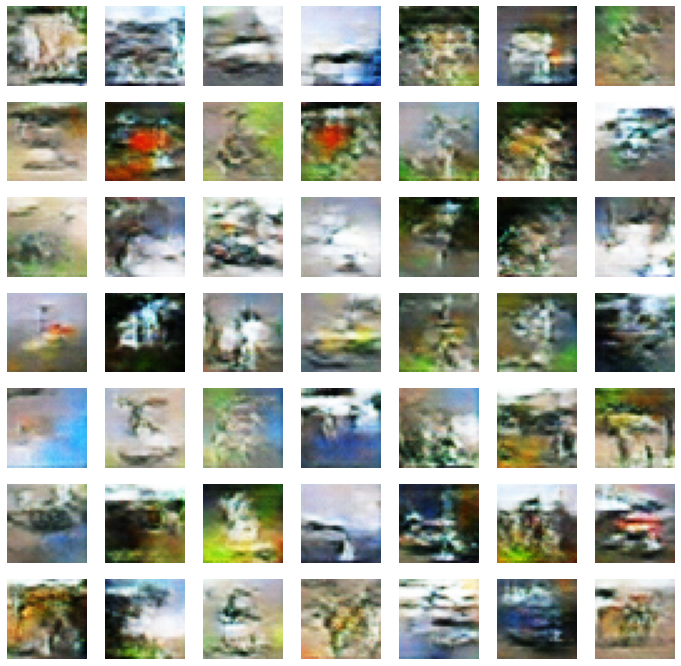

>211, 1/39, d1=0.704, d2=0.671 g=0.776
>211, 2/39, d1=0.724, d2=0.679 g=0.767
>211, 3/39, d1=0.715, d2=0.683 g=0.796
>211, 4/39, d1=0.720, d2=0.654 g=0.755
>211, 5/39, d1=0.667, d2=0.682 g=0.753
>211, 6/39, d1=0.683, d2=0.666 g=0.751
>211, 7/39, d1=0.727, d2=0.666 g=0.722
>211, 8/39, d1=0.698, d2=0.691 g=0.729
>211, 9/39, d1=0.676, d2=0.715 g=0.749
>211, 10/39, d1=0.653, d2=0.698 g=0.778
>211, 11/39, d1=0.682, d2=0.688 g=0.768
>211, 12/39, d1=0.689, d2=0.643 g=0.782
>211, 13/39, d1=0.698, d2=0.640 g=0.777
>211, 14/39, d1=0.686, d2=0.665 g=0.766
>211, 15/39, d1=0.693, d2=0.677 g=0.759
>211, 16/39, d1=0.652, d2=0.668 g=0.746
>211, 17/39, d1=0.661, d2=0.684 g=0.740
>211, 18/39, d1=0.673, d2=0.655 g=0.763
>211, 19/39, d1=0.672, d2=0.672 g=0.752
>211, 20/39, d1=0.627, d2=0.670 g=0.751
>211, 21/39, d1=0.642, d2=0.683 g=0.762
>211, 22/39, d1=0.629, d2=0.706 g=0.730
>211, 23/39, d1=0.619, d2=0.697 g=0.750
>211, 24/39, d1=0.655, d2=0.731 g=0.728
>211, 25/39, d1=0.684, d2=0.721 g=0.734
>211, 26/

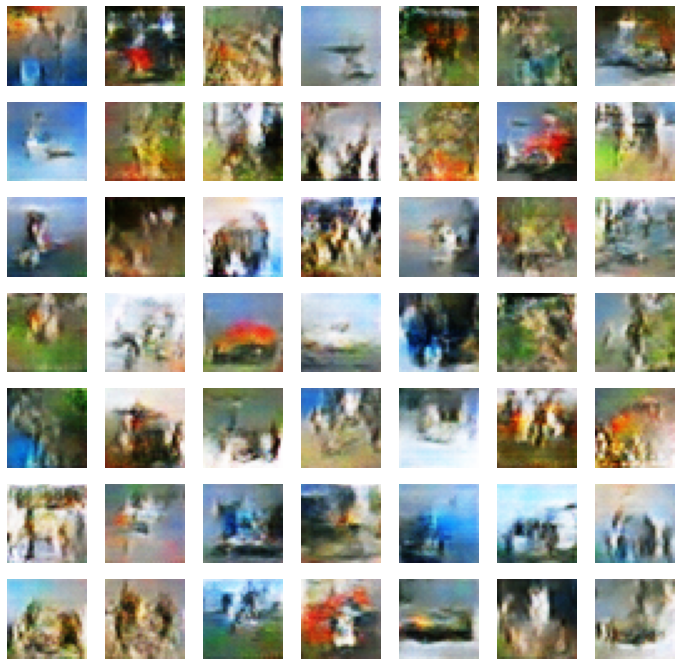

>221, 1/39, d1=0.705, d2=0.677 g=0.750
>221, 2/39, d1=0.715, d2=0.669 g=0.751
>221, 3/39, d1=0.693, d2=0.680 g=0.753
>221, 4/39, d1=0.714, d2=0.684 g=0.757
>221, 5/39, d1=0.692, d2=0.680 g=0.748
>221, 6/39, d1=0.677, d2=0.661 g=0.764
>221, 7/39, d1=0.695, d2=0.670 g=0.736
>221, 8/39, d1=0.695, d2=0.667 g=0.736
>221, 9/39, d1=0.690, d2=0.676 g=0.736
>221, 10/39, d1=0.655, d2=0.702 g=0.763
>221, 11/39, d1=0.684, d2=0.670 g=0.748
>221, 12/39, d1=0.693, d2=0.690 g=0.758
>221, 13/39, d1=0.668, d2=0.686 g=0.746
>221, 14/39, d1=0.641, d2=0.679 g=0.746
>221, 15/39, d1=0.645, d2=0.698 g=0.733
>221, 16/39, d1=0.624, d2=0.695 g=0.735
>221, 17/39, d1=0.666, d2=0.685 g=0.744
>221, 18/39, d1=0.683, d2=0.677 g=0.744
>221, 19/39, d1=0.654, d2=0.681 g=0.745
>221, 20/39, d1=0.653, d2=0.645 g=0.745
>221, 21/39, d1=0.652, d2=0.669 g=0.750
>221, 22/39, d1=0.675, d2=0.684 g=0.750
>221, 23/39, d1=0.638, d2=0.703 g=0.748
>221, 24/39, d1=0.658, d2=0.692 g=0.716
>221, 25/39, d1=0.672, d2=0.751 g=0.737
>221, 26/

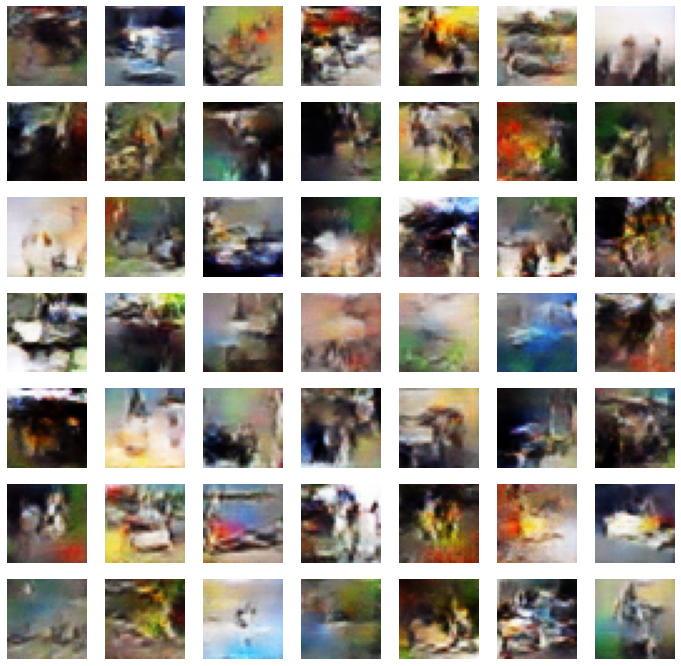

>231, 1/39, d1=0.689, d2=0.687 g=0.738
>231, 2/39, d1=0.697, d2=0.717 g=0.717
>231, 3/39, d1=0.683, d2=0.715 g=0.731
>231, 4/39, d1=0.676, d2=0.708 g=0.737
>231, 5/39, d1=0.686, d2=0.681 g=0.756
>231, 6/39, d1=0.694, d2=0.698 g=0.747
>231, 7/39, d1=0.703, d2=0.688 g=0.752
>231, 8/39, d1=0.717, d2=0.655 g=0.790
>231, 9/39, d1=0.708, d2=0.666 g=0.776
>231, 10/39, d1=0.700, d2=0.625 g=0.778
>231, 11/39, d1=0.703, d2=0.664 g=0.753
>231, 12/39, d1=0.685, d2=0.680 g=0.754
>231, 13/39, d1=0.688, d2=0.724 g=0.744
>231, 14/39, d1=0.736, d2=0.709 g=0.729
>231, 15/39, d1=0.714, d2=0.699 g=0.746
>231, 16/39, d1=0.709, d2=0.696 g=0.749
>231, 17/39, d1=0.713, d2=0.691 g=0.772
>231, 18/39, d1=0.728, d2=0.660 g=0.769
>231, 19/39, d1=0.696, d2=0.645 g=0.771
>231, 20/39, d1=0.733, d2=0.657 g=0.775
>231, 21/39, d1=0.709, d2=0.656 g=0.765
>231, 22/39, d1=0.715, d2=0.671 g=0.759
>231, 23/39, d1=0.699, d2=0.648 g=0.757
>231, 24/39, d1=0.710, d2=0.664 g=0.746
>231, 25/39, d1=0.715, d2=0.672 g=0.733
>231, 26/

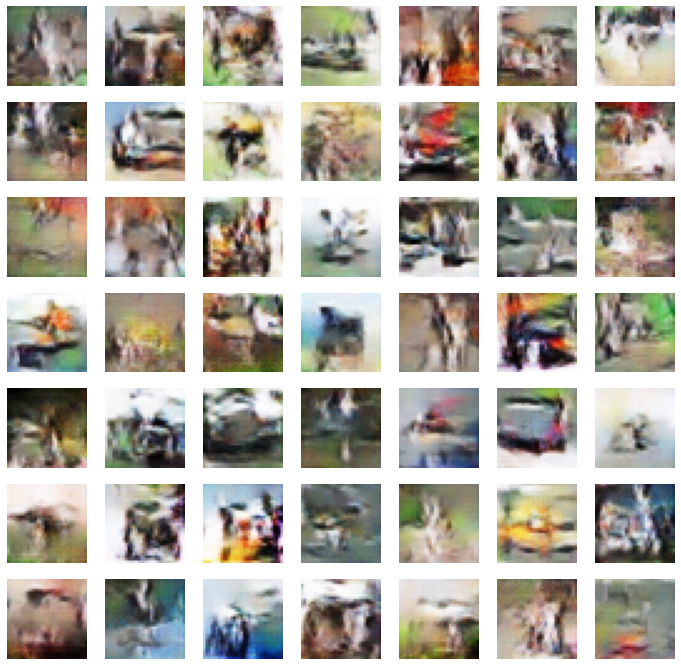

>241, 1/39, d1=0.698, d2=0.670 g=0.750
>241, 2/39, d1=0.677, d2=0.682 g=0.746
>241, 3/39, d1=0.687, d2=0.728 g=0.758
>241, 4/39, d1=0.665, d2=0.736 g=0.727
>241, 5/39, d1=0.721, d2=0.754 g=0.700
>241, 6/39, d1=0.682, d2=0.730 g=0.682
>241, 7/39, d1=0.695, d2=0.713 g=0.707
>241, 8/39, d1=0.683, d2=0.692 g=0.722
>241, 9/39, d1=0.697, d2=0.701 g=0.760
>241, 10/39, d1=0.697, d2=0.652 g=0.771
>241, 11/39, d1=0.705, d2=0.671 g=0.755
>241, 12/39, d1=0.670, d2=0.687 g=0.764
>241, 13/39, d1=0.696, d2=0.682 g=0.738
>241, 14/39, d1=0.683, d2=0.694 g=0.734
>241, 15/39, d1=0.683, d2=0.694 g=0.731
>241, 16/39, d1=0.698, d2=0.693 g=0.741
>241, 17/39, d1=0.671, d2=0.701 g=0.736
>241, 18/39, d1=0.692, d2=0.690 g=0.747
>241, 19/39, d1=0.679, d2=0.691 g=0.740
>241, 20/39, d1=0.680, d2=0.677 g=0.738
>241, 21/39, d1=0.696, d2=0.689 g=0.740
>241, 22/39, d1=0.687, d2=0.698 g=0.746
>241, 23/39, d1=0.670, d2=0.684 g=0.728
>241, 24/39, d1=0.689, d2=0.690 g=0.735
>241, 25/39, d1=0.665, d2=0.687 g=0.760
>241, 26/

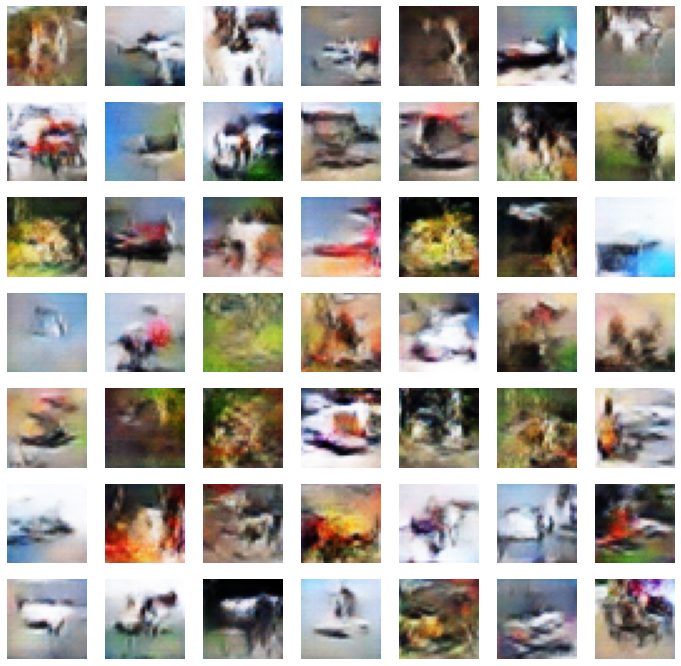

>251, 1/39, d1=0.688, d2=0.720 g=0.751
>251, 2/39, d1=0.684, d2=0.711 g=0.733
>251, 3/39, d1=0.673, d2=0.740 g=0.705
>251, 4/39, d1=0.716, d2=0.734 g=0.701
>251, 5/39, d1=0.689, d2=0.743 g=0.708
>251, 6/39, d1=0.671, d2=0.732 g=0.709
>251, 7/39, d1=0.664, d2=0.690 g=0.744
>251, 8/39, d1=0.697, d2=0.689 g=0.762
>251, 9/39, d1=0.713, d2=0.677 g=0.776
>251, 10/39, d1=0.688, d2=0.672 g=0.766
>251, 11/39, d1=0.690, d2=0.674 g=0.771
>251, 12/39, d1=0.729, d2=0.669 g=0.748
>251, 13/39, d1=0.695, d2=0.683 g=0.753
>251, 14/39, d1=0.711, d2=0.681 g=0.750
>251, 15/39, d1=0.695, d2=0.657 g=0.759
>251, 16/39, d1=0.692, d2=0.688 g=0.756
>251, 17/39, d1=0.704, d2=0.650 g=0.795
>251, 18/39, d1=0.734, d2=0.700 g=0.747
>251, 19/39, d1=0.701, d2=0.692 g=0.748
>251, 20/39, d1=0.682, d2=0.715 g=0.736
>251, 21/39, d1=0.715, d2=0.673 g=0.729
>251, 22/39, d1=0.722, d2=0.667 g=0.758
>251, 23/39, d1=0.747, d2=0.685 g=0.730
>251, 24/39, d1=0.715, d2=0.671 g=0.734
>251, 25/39, d1=0.697, d2=0.702 g=0.745
>251, 26/

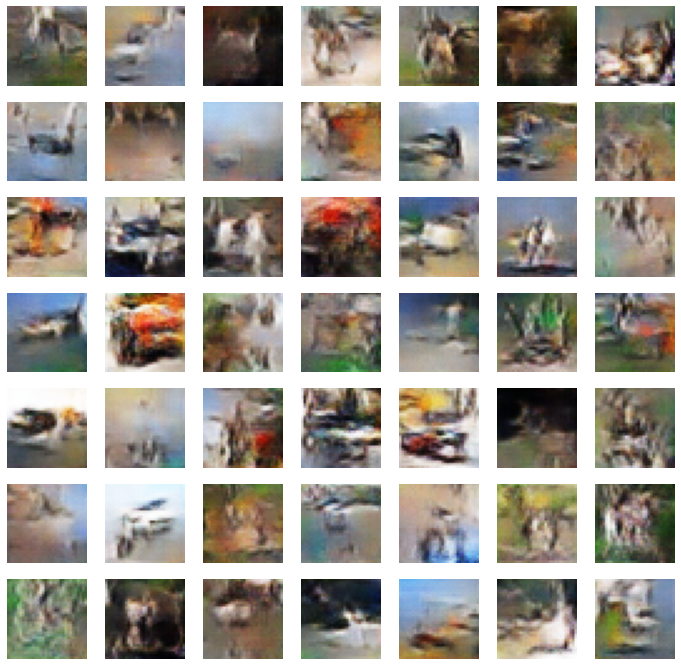

>261, 1/39, d1=0.670, d2=0.733 g=0.706
>261, 2/39, d1=0.656, d2=0.742 g=0.685
>261, 3/39, d1=0.679, d2=0.704 g=0.701
>261, 4/39, d1=0.657, d2=0.696 g=0.706
>261, 5/39, d1=0.655, d2=0.666 g=0.753
>261, 6/39, d1=0.685, d2=0.700 g=0.734
>261, 7/39, d1=0.708, d2=0.679 g=0.741
>261, 8/39, d1=0.688, d2=0.658 g=0.742
>261, 9/39, d1=0.687, d2=0.711 g=0.717
>261, 10/39, d1=0.675, d2=0.710 g=0.707
>261, 11/39, d1=0.694, d2=0.744 g=0.704
>261, 12/39, d1=0.671, d2=0.740 g=0.694
>261, 13/39, d1=0.668, d2=0.740 g=0.715
>261, 14/39, d1=0.696, d2=0.678 g=0.766
>261, 15/39, d1=0.688, d2=0.656 g=0.797
>261, 16/39, d1=0.729, d2=0.618 g=0.850
>261, 17/39, d1=0.727, d2=0.610 g=0.860
>261, 18/39, d1=0.714, d2=0.600 g=0.805
>261, 19/39, d1=0.718, d2=0.657 g=0.767
>261, 20/39, d1=0.705, d2=0.691 g=0.754
>261, 21/39, d1=0.716, d2=0.709 g=0.722
>261, 22/39, d1=0.723, d2=0.699 g=0.731
>261, 23/39, d1=0.689, d2=0.676 g=0.741
>261, 24/39, d1=0.678, d2=0.675 g=0.749
>261, 25/39, d1=0.690, d2=0.665 g=0.768
>261, 26/

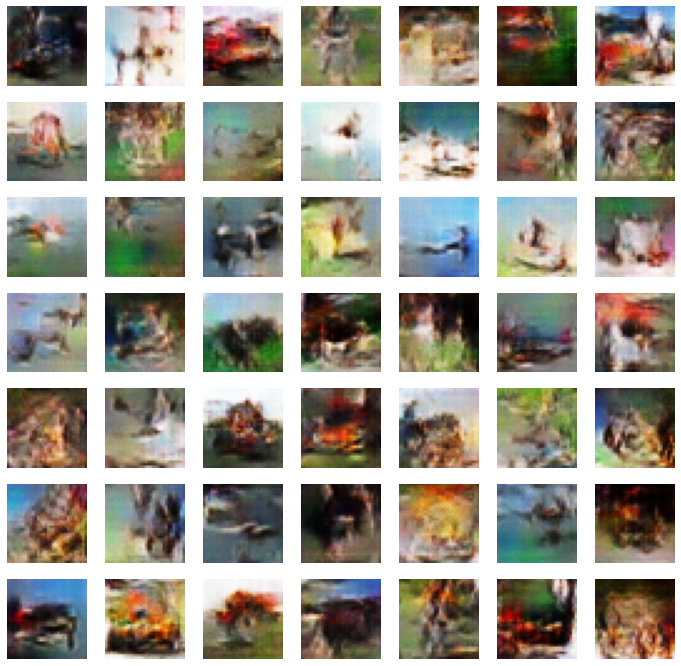

>271, 1/39, d1=0.719, d2=0.687 g=0.739
>271, 2/39, d1=0.709, d2=0.668 g=0.743
>271, 3/39, d1=0.700, d2=0.691 g=0.742
>271, 4/39, d1=0.672, d2=0.639 g=0.756
>271, 5/39, d1=0.709, d2=0.629 g=0.773
>271, 6/39, d1=0.688, d2=0.656 g=0.786
>271, 7/39, d1=0.699, d2=0.633 g=0.767
>271, 8/39, d1=0.686, d2=0.695 g=0.739
>271, 9/39, d1=0.696, d2=0.706 g=0.715
>271, 10/39, d1=0.681, d2=0.710 g=0.706
>271, 11/39, d1=0.664, d2=0.723 g=0.709
>271, 12/39, d1=0.662, d2=0.715 g=0.700
>271, 13/39, d1=0.688, d2=0.702 g=0.711
>271, 14/39, d1=0.678, d2=0.723 g=0.708
>271, 15/39, d1=0.650, d2=0.701 g=0.724
>271, 16/39, d1=0.685, d2=0.730 g=0.728
>271, 17/39, d1=0.693, d2=0.702 g=0.708
>271, 18/39, d1=0.686, d2=0.710 g=0.696
>271, 19/39, d1=0.669, d2=0.717 g=0.716
>271, 20/39, d1=0.672, d2=0.710 g=0.727
>271, 21/39, d1=0.700, d2=0.697 g=0.738
>271, 22/39, d1=0.678, d2=0.698 g=0.744
>271, 23/39, d1=0.707, d2=0.670 g=0.744
>271, 24/39, d1=0.705, d2=0.655 g=0.752
>271, 25/39, d1=0.693, d2=0.625 g=0.745
>271, 26/

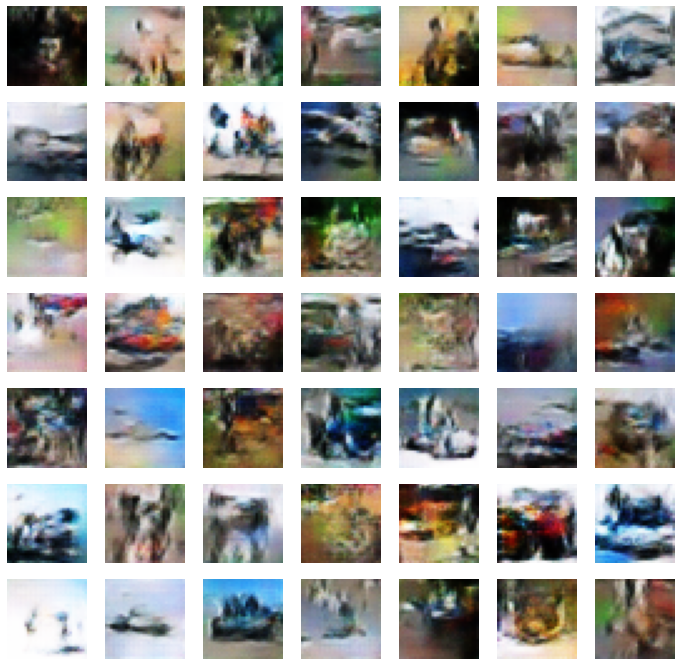

>281, 1/39, d1=0.698, d2=0.676 g=0.735
>281, 2/39, d1=0.670, d2=0.670 g=0.753
>281, 3/39, d1=0.706, d2=0.677 g=0.750
>281, 4/39, d1=0.687, d2=0.689 g=0.747
>281, 5/39, d1=0.674, d2=0.712 g=0.709
>281, 6/39, d1=0.689, d2=0.716 g=0.706
>281, 7/39, d1=0.712, d2=0.738 g=0.721
>281, 8/39, d1=0.697, d2=0.721 g=0.719
>281, 9/39, d1=0.725, d2=0.712 g=0.736
>281, 10/39, d1=0.686, d2=0.701 g=0.746
>281, 11/39, d1=0.689, d2=0.680 g=0.727
>281, 12/39, d1=0.692, d2=0.704 g=0.747
>281, 13/39, d1=0.700, d2=0.660 g=0.760
>281, 14/39, d1=0.711, d2=0.665 g=0.763
>281, 15/39, d1=0.707, d2=0.664 g=0.750
>281, 16/39, d1=0.677, d2=0.668 g=0.761
>281, 17/39, d1=0.671, d2=0.676 g=0.760
>281, 18/39, d1=0.701, d2=0.666 g=0.744
>281, 19/39, d1=0.717, d2=0.706 g=0.719
>281, 20/39, d1=0.707, d2=0.688 g=0.734
>281, 21/39, d1=0.713, d2=0.688 g=0.722
>281, 22/39, d1=0.706, d2=0.722 g=0.702
>281, 23/39, d1=0.697, d2=0.701 g=0.721
>281, 24/39, d1=0.707, d2=0.694 g=0.758
>281, 25/39, d1=0.714, d2=0.651 g=0.741
>281, 26/

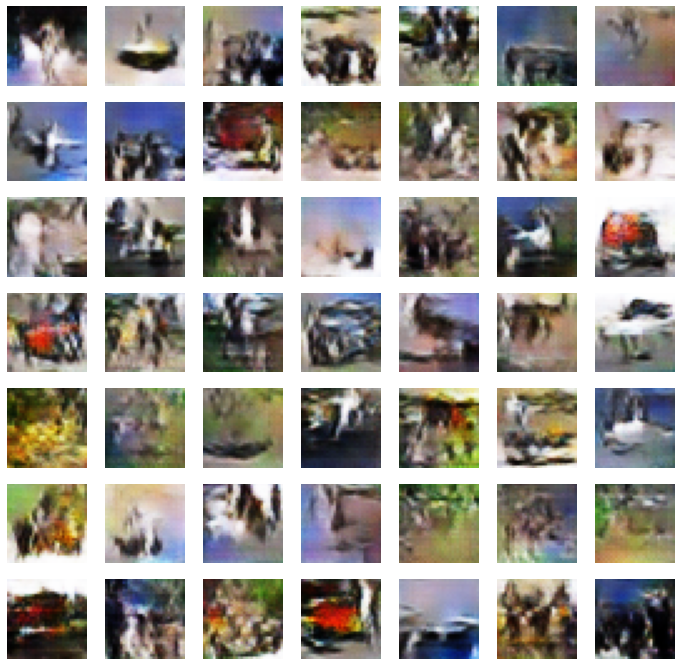

>291, 1/39, d1=0.679, d2=0.711 g=0.721
>291, 2/39, d1=0.687, d2=0.694 g=0.720
>291, 3/39, d1=0.703, d2=0.693 g=0.748
>291, 4/39, d1=0.677, d2=0.712 g=0.740
>291, 5/39, d1=0.700, d2=0.686 g=0.749
>291, 6/39, d1=0.701, d2=0.697 g=0.755
>291, 7/39, d1=0.693, d2=0.681 g=0.720
>291, 8/39, d1=0.692, d2=0.684 g=0.731
>291, 9/39, d1=0.716, d2=0.714 g=0.721
>291, 10/39, d1=0.718, d2=0.730 g=0.737
>291, 11/39, d1=0.700, d2=0.698 g=0.733
>291, 12/39, d1=0.695, d2=0.711 g=0.755
>291, 13/39, d1=0.692, d2=0.655 g=0.733
>291, 14/39, d1=0.739, d2=0.674 g=0.736
>291, 15/39, d1=0.710, d2=0.681 g=0.755
>291, 16/39, d1=0.724, d2=0.656 g=0.762
>291, 17/39, d1=0.717, d2=0.683 g=0.751
>291, 18/39, d1=0.700, d2=0.679 g=0.739
>291, 19/39, d1=0.693, d2=0.690 g=0.738
>291, 20/39, d1=0.705, d2=0.697 g=0.727
>291, 21/39, d1=0.705, d2=0.693 g=0.726
>291, 22/39, d1=0.710, d2=0.689 g=0.730
>291, 23/39, d1=0.693, d2=0.693 g=0.760
>291, 24/39, d1=0.701, d2=0.653 g=0.753
>291, 25/39, d1=0.680, d2=0.676 g=0.767
>291, 26/

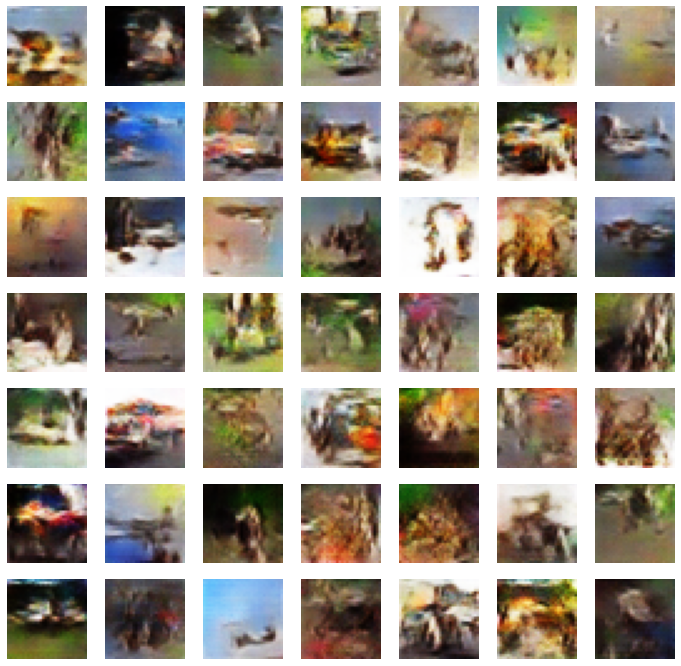

>301, 1/39, d1=0.699, d2=0.626 g=0.796
>301, 2/39, d1=0.721, d2=0.678 g=0.752
>301, 3/39, d1=0.704, d2=0.683 g=0.770
>301, 4/39, d1=0.646, d2=0.688 g=0.747
>301, 5/39, d1=0.703, d2=0.707 g=0.721
>301, 6/39, d1=0.696, d2=0.710 g=0.711
>301, 7/39, d1=0.697, d2=0.704 g=0.718
>301, 8/39, d1=0.689, d2=0.706 g=0.716
>301, 9/39, d1=0.685, d2=0.701 g=0.725
>301, 10/39, d1=0.682, d2=0.684 g=0.748
>301, 11/39, d1=0.682, d2=0.664 g=0.786
>301, 12/39, d1=0.688, d2=0.669 g=0.793
>301, 13/39, d1=0.686, d2=0.676 g=0.778
>301, 14/39, d1=0.677, d2=0.700 g=0.738
>301, 15/39, d1=0.676, d2=0.676 g=0.712
>301, 16/39, d1=0.679, d2=0.741 g=0.688
>301, 17/39, d1=0.662, d2=0.747 g=0.680
>301, 18/39, d1=0.694, d2=0.742 g=0.682
>301, 19/39, d1=0.667, d2=0.753 g=0.709
>301, 20/39, d1=0.702, d2=0.719 g=0.733
>301, 21/39, d1=0.676, d2=0.664 g=0.760
>301, 22/39, d1=0.720, d2=0.661 g=0.777
>301, 23/39, d1=0.706, d2=0.679 g=0.782
>301, 24/39, d1=0.681, d2=0.627 g=0.824
>301, 25/39, d1=0.702, d2=0.645 g=0.794
>301, 26/

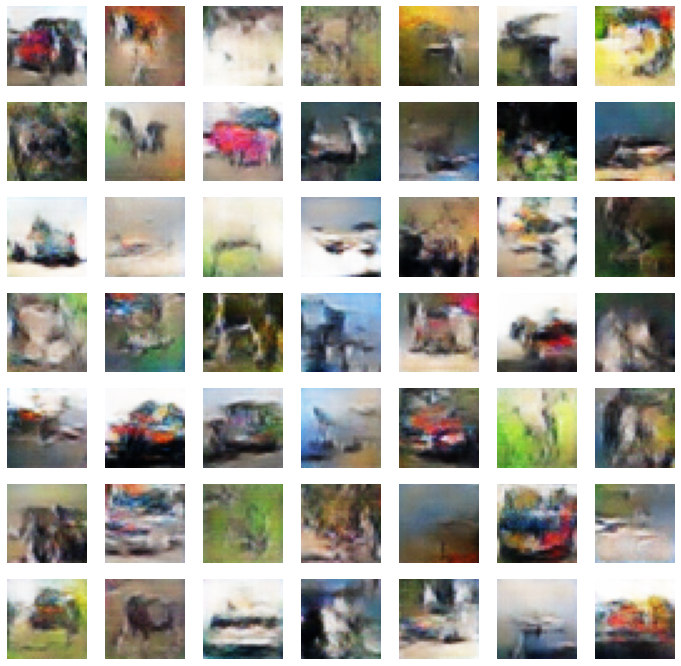

>311, 1/39, d1=0.718, d2=0.692 g=0.719
>311, 2/39, d1=0.721, d2=0.706 g=0.726
>311, 3/39, d1=0.680, d2=0.714 g=0.709
>311, 4/39, d1=0.694, d2=0.682 g=0.711
>311, 5/39, d1=0.680, d2=0.711 g=0.712
>311, 6/39, d1=0.681, d2=0.728 g=0.705
>311, 7/39, d1=0.705, d2=0.696 g=0.710
>311, 8/39, d1=0.708, d2=0.700 g=0.736
>311, 9/39, d1=0.691, d2=0.662 g=0.771
>311, 10/39, d1=0.692, d2=0.652 g=0.768
>311, 11/39, d1=0.707, d2=0.661 g=0.753
>311, 12/39, d1=0.690, d2=0.649 g=0.745
>311, 13/39, d1=0.677, d2=0.698 g=0.722
>311, 14/39, d1=0.695, d2=0.705 g=0.708
>311, 15/39, d1=0.680, d2=0.717 g=0.709
>311, 16/39, d1=0.695, d2=0.719 g=0.702
>311, 17/39, d1=0.682, d2=0.718 g=0.707
>311, 18/39, d1=0.703, d2=0.708 g=0.722
>311, 19/39, d1=0.679, d2=0.695 g=0.722
>311, 20/39, d1=0.681, d2=0.673 g=0.742
>311, 21/39, d1=0.698, d2=0.688 g=0.744
>311, 22/39, d1=0.709, d2=0.682 g=0.741
>311, 23/39, d1=0.710, d2=0.675 g=0.743
>311, 24/39, d1=0.699, d2=0.692 g=0.764
>311, 25/39, d1=0.680, d2=0.678 g=0.748
>311, 26/

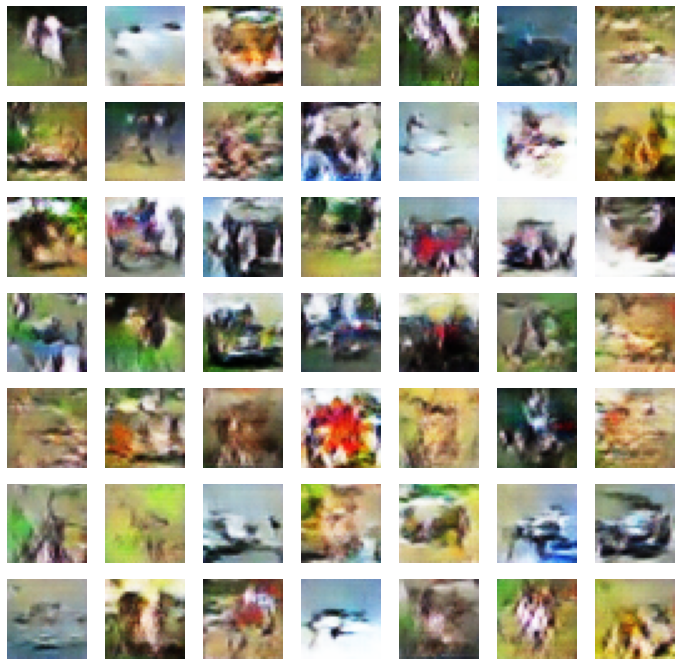

>321, 1/39, d1=0.697, d2=0.685 g=0.705
>321, 2/39, d1=0.705, d2=0.722 g=0.694
>321, 3/39, d1=0.686, d2=0.734 g=0.704
>321, 4/39, d1=0.677, d2=0.734 g=0.703
>321, 5/39, d1=0.699, d2=0.726 g=0.694
>321, 6/39, d1=0.701, d2=0.690 g=0.718
>321, 7/39, d1=0.684, d2=0.697 g=0.745
>321, 8/39, d1=0.742, d2=0.678 g=0.756
>321, 9/39, d1=0.709, d2=0.668 g=0.747
>321, 10/39, d1=0.685, d2=0.665 g=0.766
>321, 11/39, d1=0.721, d2=0.663 g=0.731
>321, 12/39, d1=0.714, d2=0.699 g=0.734
>321, 13/39, d1=0.735, d2=0.696 g=0.736
>321, 14/39, d1=0.710, d2=0.672 g=0.743
>321, 15/39, d1=0.689, d2=0.664 g=0.756
>321, 16/39, d1=0.725, d2=0.655 g=0.741
>321, 17/39, d1=0.690, d2=0.675 g=0.761
>321, 18/39, d1=0.686, d2=0.676 g=0.741
>321, 19/39, d1=0.702, d2=0.700 g=0.743
>321, 20/39, d1=0.698, d2=0.683 g=0.730
>321, 21/39, d1=0.683, d2=0.696 g=0.719
>321, 22/39, d1=0.705, d2=0.709 g=0.710
>321, 23/39, d1=0.690, d2=0.714 g=0.710
>321, 24/39, d1=0.696, d2=0.700 g=0.718
>321, 25/39, d1=0.669, d2=0.687 g=0.721
>321, 26/

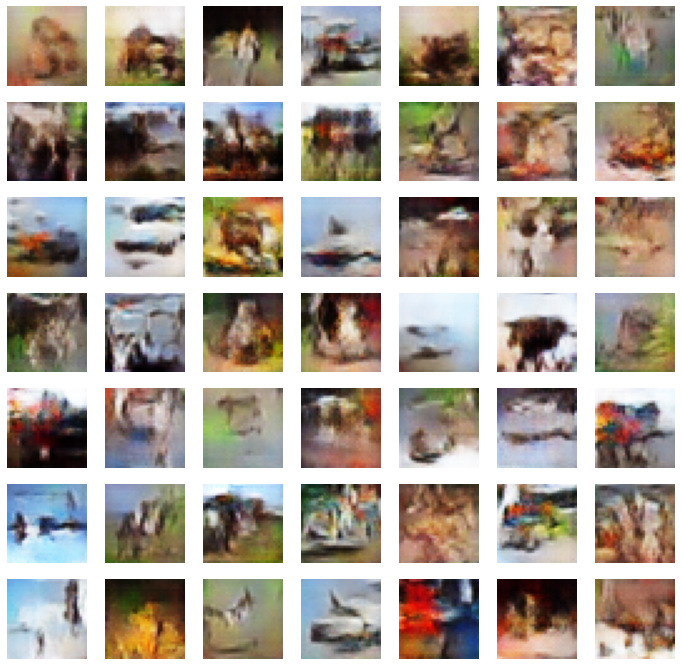

>331, 1/39, d1=0.728, d2=0.657 g=0.761
>331, 2/39, d1=0.683, d2=0.681 g=0.745
>331, 3/39, d1=0.684, d2=0.680 g=0.719
>331, 4/39, d1=0.684, d2=0.686 g=0.704
>331, 5/39, d1=0.706, d2=0.712 g=0.694
>331, 6/39, d1=0.676, d2=0.708 g=0.698
>331, 7/39, d1=0.700, d2=0.721 g=0.706
>331, 8/39, d1=0.696, d2=0.718 g=0.711
>331, 9/39, d1=0.680, d2=0.697 g=0.735
>331, 10/39, d1=0.682, d2=0.677 g=0.746
>331, 11/39, d1=0.691, d2=0.681 g=0.756
>331, 12/39, d1=0.678, d2=0.677 g=0.751
>331, 13/39, d1=0.725, d2=0.671 g=0.741
>331, 14/39, d1=0.687, d2=0.676 g=0.750
>331, 15/39, d1=0.694, d2=0.691 g=0.740
>331, 16/39, d1=0.682, d2=0.703 g=0.748
>331, 17/39, d1=0.708, d2=0.701 g=0.732
>331, 18/39, d1=0.692, d2=0.700 g=0.742
>331, 19/39, d1=0.690, d2=0.662 g=0.750
>331, 20/39, d1=0.692, d2=0.667 g=0.742
>331, 21/39, d1=0.690, d2=0.685 g=0.751
>331, 22/39, d1=0.661, d2=0.716 g=0.719
>331, 23/39, d1=0.678, d2=0.707 g=0.745
>331, 24/39, d1=0.666, d2=0.718 g=0.717
>331, 25/39, d1=0.691, d2=0.736 g=0.716
>331, 26/

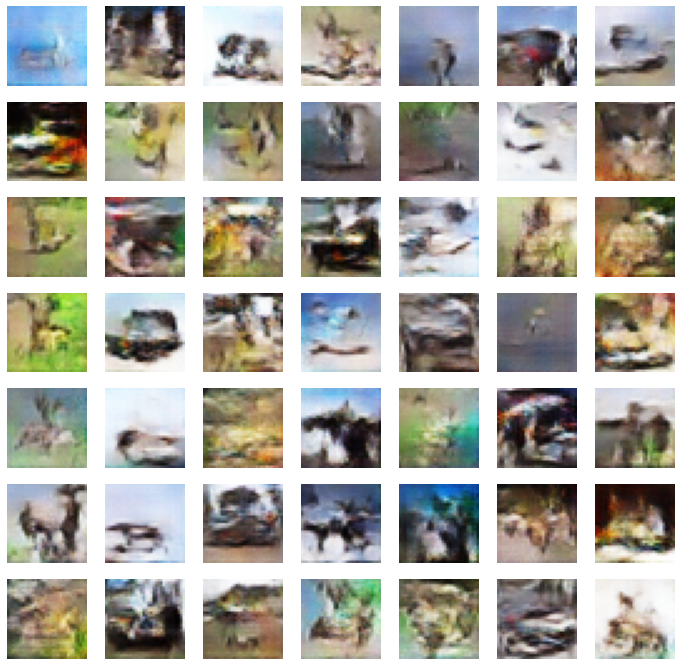

>341, 1/39, d1=0.674, d2=0.674 g=0.691
>341, 2/39, d1=0.676, d2=0.712 g=0.697
>341, 3/39, d1=0.690, d2=0.732 g=0.703
>341, 4/39, d1=0.687, d2=0.735 g=0.713
>341, 5/39, d1=0.685, d2=0.714 g=0.715
>341, 6/39, d1=0.713, d2=0.690 g=0.734
>341, 7/39, d1=0.664, d2=0.677 g=0.734
>341, 8/39, d1=0.698, d2=0.689 g=0.752
>341, 9/39, d1=0.699, d2=0.656 g=0.756
>341, 10/39, d1=0.701, d2=0.661 g=0.751
>341, 11/39, d1=0.691, d2=0.676 g=0.737
>341, 12/39, d1=0.708, d2=0.672 g=0.739
>341, 13/39, d1=0.685, d2=0.694 g=0.711
>341, 14/39, d1=0.700, d2=0.699 g=0.728
>341, 15/39, d1=0.712, d2=0.690 g=0.731
>341, 16/39, d1=0.706, d2=0.687 g=0.728
>341, 17/39, d1=0.709, d2=0.670 g=0.752
>341, 18/39, d1=0.725, d2=0.688 g=0.737
>341, 19/39, d1=0.706, d2=0.668 g=0.746
>341, 20/39, d1=0.683, d2=0.661 g=0.739
>341, 21/39, d1=0.683, d2=0.682 g=0.753
>341, 22/39, d1=0.679, d2=0.685 g=0.736
>341, 23/39, d1=0.673, d2=0.684 g=0.735
>341, 24/39, d1=0.683, d2=0.661 g=0.750
>341, 25/39, d1=0.667, d2=0.668 g=0.745
>341, 26/

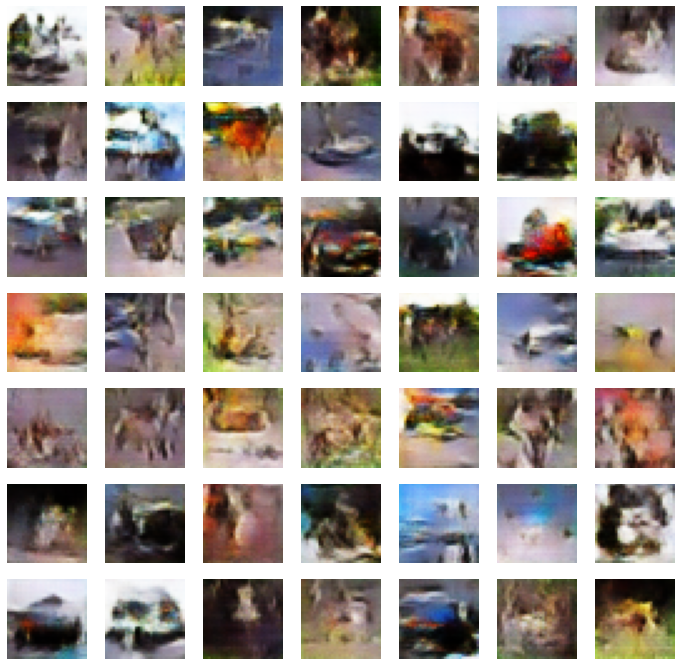

>351, 1/39, d1=0.683, d2=0.710 g=0.716
>351, 2/39, d1=0.666, d2=0.686 g=0.711
>351, 3/39, d1=0.697, d2=0.702 g=0.714
>351, 4/39, d1=0.676, d2=0.700 g=0.717
>351, 5/39, d1=0.678, d2=0.711 g=0.711
>351, 6/39, d1=0.668, d2=0.712 g=0.734
>351, 7/39, d1=0.695, d2=0.688 g=0.735
>351, 8/39, d1=0.695, d2=0.675 g=0.749
>351, 9/39, d1=0.703, d2=0.667 g=0.741
>351, 10/39, d1=0.685, d2=0.676 g=0.750
>351, 11/39, d1=0.698, d2=0.684 g=0.739
>351, 12/39, d1=0.681, d2=0.673 g=0.732
>351, 13/39, d1=0.715, d2=0.685 g=0.739
>351, 14/39, d1=0.676, d2=0.701 g=0.726
>351, 15/39, d1=0.679, d2=0.703 g=0.725
>351, 16/39, d1=0.682, d2=0.687 g=0.730
>351, 17/39, d1=0.695, d2=0.695 g=0.721
>351, 18/39, d1=0.690, d2=0.710 g=0.721
>351, 19/39, d1=0.674, d2=0.687 g=0.735
>351, 20/39, d1=0.705, d2=0.675 g=0.738
>351, 21/39, d1=0.703, d2=0.684 g=0.748
>351, 22/39, d1=0.708, d2=0.662 g=0.759
>351, 23/39, d1=0.697, d2=0.669 g=0.746
>351, 24/39, d1=0.718, d2=0.665 g=0.741
>351, 25/39, d1=0.676, d2=0.673 g=0.746
>351, 26/

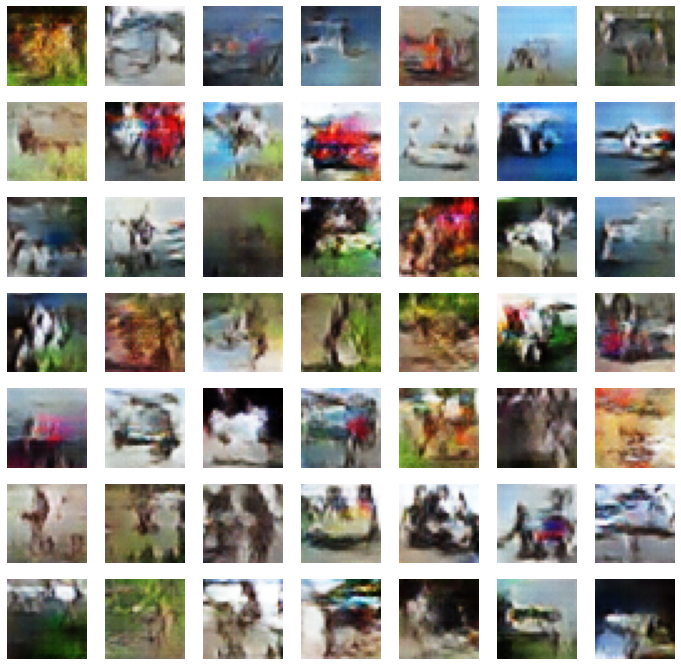

>361, 1/39, d1=0.690, d2=0.697 g=0.726
>361, 2/39, d1=0.680, d2=0.701 g=0.746
>361, 3/39, d1=0.703, d2=0.683 g=0.717
>361, 4/39, d1=0.705, d2=0.686 g=0.727
>361, 5/39, d1=0.696, d2=0.672 g=0.733
>361, 6/39, d1=0.694, d2=0.668 g=0.725
>361, 7/39, d1=0.697, d2=0.676 g=0.747
>361, 8/39, d1=0.704, d2=0.676 g=0.734
>361, 9/39, d1=0.696, d2=0.678 g=0.742
>361, 10/39, d1=0.667, d2=0.674 g=0.746
>361, 11/39, d1=0.704, d2=0.675 g=0.740
>361, 12/39, d1=0.694, d2=0.658 g=0.749
>361, 13/39, d1=0.667, d2=0.672 g=0.746
>361, 14/39, d1=0.672, d2=0.686 g=0.741
>361, 15/39, d1=0.678, d2=0.671 g=0.738
>361, 16/39, d1=0.706, d2=0.687 g=0.729
>361, 17/39, d1=0.699, d2=0.690 g=0.718
>361, 18/39, d1=0.689, d2=0.712 g=0.722
>361, 19/39, d1=0.681, d2=0.665 g=0.722
>361, 20/39, d1=0.689, d2=0.706 g=0.715
>361, 21/39, d1=0.673, d2=0.702 g=0.718
>361, 22/39, d1=0.683, d2=0.665 g=0.734
>361, 23/39, d1=0.693, d2=0.686 g=0.733
>361, 24/39, d1=0.690, d2=0.696 g=0.748
>361, 25/39, d1=0.696, d2=0.676 g=0.755
>361, 26/

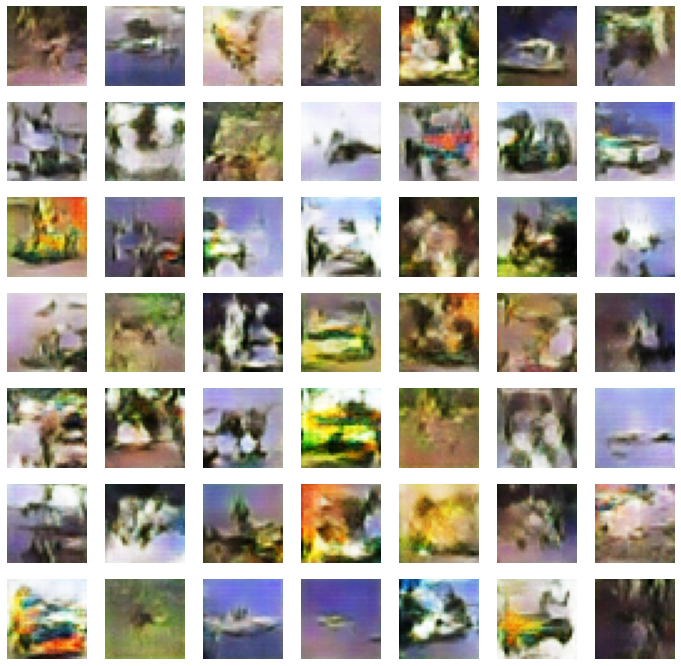

>371, 1/39, d1=0.699, d2=0.667 g=0.773
>371, 2/39, d1=0.725, d2=0.639 g=0.768
>371, 3/39, d1=0.710, d2=0.683 g=0.752
>371, 4/39, d1=0.692, d2=0.689 g=0.741
>371, 5/39, d1=0.707, d2=0.706 g=0.734
>371, 6/39, d1=0.691, d2=0.686 g=0.710
>371, 7/39, d1=0.684, d2=0.669 g=0.720
>371, 8/39, d1=0.699, d2=0.713 g=0.727
>371, 9/39, d1=0.712, d2=0.686 g=0.729
>371, 10/39, d1=0.686, d2=0.682 g=0.723
>371, 11/39, d1=0.679, d2=0.667 g=0.736
>371, 12/39, d1=0.675, d2=0.684 g=0.765
>371, 13/39, d1=0.701, d2=0.677 g=0.743
>371, 14/39, d1=0.681, d2=0.676 g=0.740
>371, 15/39, d1=0.683, d2=0.682 g=0.738
>371, 16/39, d1=0.661, d2=0.671 g=0.744
>371, 17/39, d1=0.710, d2=0.655 g=0.755
>371, 18/39, d1=0.684, d2=0.670 g=0.741
>371, 19/39, d1=0.682, d2=0.680 g=0.731
>371, 20/39, d1=0.653, d2=0.712 g=0.696
>371, 21/39, d1=0.697, d2=0.720 g=0.696
>371, 22/39, d1=0.682, d2=0.702 g=0.703
>371, 23/39, d1=0.697, d2=0.681 g=0.729
>371, 24/39, d1=0.714, d2=0.698 g=0.738
>371, 25/39, d1=0.697, d2=0.687 g=0.748
>371, 26/

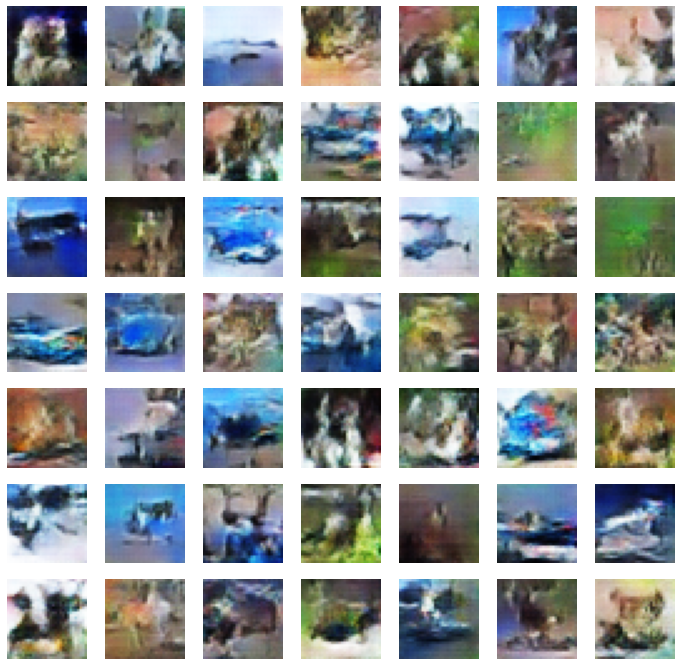

>381, 1/39, d1=0.672, d2=0.694 g=0.755
>381, 2/39, d1=0.693, d2=0.689 g=0.744
>381, 3/39, d1=0.710, d2=0.678 g=0.750
>381, 4/39, d1=0.711, d2=0.708 g=0.756
>381, 5/39, d1=0.681, d2=0.688 g=0.755
>381, 6/39, d1=0.690, d2=0.639 g=0.775
>381, 7/39, d1=0.697, d2=0.654 g=0.755
>381, 8/39, d1=0.683, d2=0.674 g=0.772
>381, 9/39, d1=0.712, d2=0.632 g=0.771
>381, 10/39, d1=0.706, d2=0.663 g=0.764
>381, 11/39, d1=0.710, d2=0.675 g=0.731
>381, 12/39, d1=0.692, d2=0.682 g=0.720
>381, 13/39, d1=0.701, d2=0.711 g=0.721
>381, 14/39, d1=0.692, d2=0.686 g=0.702
>381, 15/39, d1=0.691, d2=0.694 g=0.714
>381, 16/39, d1=0.697, d2=0.731 g=0.694
>381, 17/39, d1=0.672, d2=0.704 g=0.726
>381, 18/39, d1=0.682, d2=0.706 g=0.714
>381, 19/39, d1=0.681, d2=0.679 g=0.716
>381, 20/39, d1=0.673, d2=0.682 g=0.736
>381, 21/39, d1=0.698, d2=0.646 g=0.771
>381, 22/39, d1=0.684, d2=0.660 g=0.757
>381, 23/39, d1=0.657, d2=0.668 g=0.753
>381, 24/39, d1=0.701, d2=0.680 g=0.750
>381, 25/39, d1=0.670, d2=0.699 g=0.729
>381, 26/

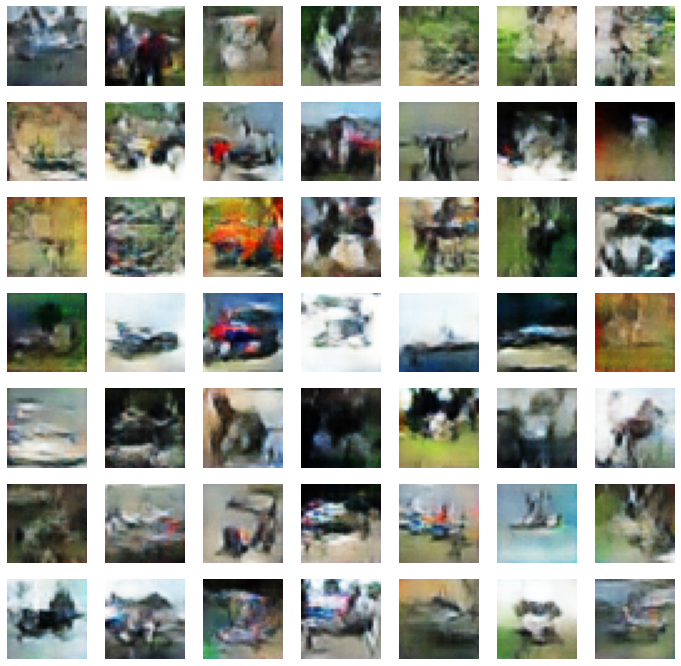

>391, 1/39, d1=0.686, d2=0.716 g=0.710
>391, 2/39, d1=0.720, d2=0.724 g=0.715
>391, 3/39, d1=0.680, d2=0.688 g=0.722
>391, 4/39, d1=0.704, d2=0.696 g=0.717
>391, 5/39, d1=0.642, d2=0.703 g=0.718
>391, 6/39, d1=0.701, d2=0.690 g=0.730
>391, 7/39, d1=0.684, d2=0.670 g=0.740
>391, 8/39, d1=0.687, d2=0.696 g=0.732
>391, 9/39, d1=0.664, d2=0.691 g=0.718
>391, 10/39, d1=0.681, d2=0.686 g=0.724
>391, 11/39, d1=0.702, d2=0.721 g=0.715
>391, 12/39, d1=0.683, d2=0.683 g=0.742
>391, 13/39, d1=0.696, d2=0.712 g=0.719
>391, 14/39, d1=0.702, d2=0.703 g=0.749
>391, 15/39, d1=0.712, d2=0.680 g=0.737
>391, 16/39, d1=0.688, d2=0.663 g=0.743
>391, 17/39, d1=0.695, d2=0.660 g=0.757
>391, 18/39, d1=0.671, d2=0.673 g=0.753
>391, 19/39, d1=0.668, d2=0.654 g=0.775
>391, 20/39, d1=0.689, d2=0.655 g=0.748
>391, 21/39, d1=0.682, d2=0.647 g=0.748
>391, 22/39, d1=0.700, d2=0.658 g=0.740
>391, 23/39, d1=0.692, d2=0.690 g=0.728
>391, 24/39, d1=0.701, d2=0.696 g=0.711
>391, 25/39, d1=0.704, d2=0.711 g=0.714
>391, 26/

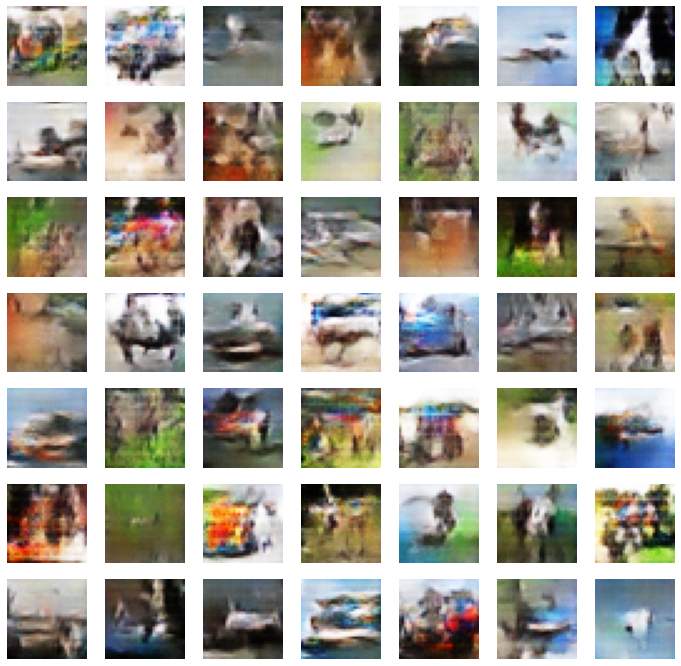

>401, 1/39, d1=0.705, d2=0.668 g=0.772
>401, 2/39, d1=0.666, d2=0.704 g=0.726
>401, 3/39, d1=0.694, d2=0.678 g=0.744
>401, 4/39, d1=0.672, d2=0.675 g=0.732
>401, 5/39, d1=0.686, d2=0.691 g=0.727
>401, 6/39, d1=0.705, d2=0.716 g=0.741
>401, 7/39, d1=0.688, d2=0.685 g=0.762
>401, 8/39, d1=0.689, d2=0.694 g=0.751
>401, 9/39, d1=0.703, d2=0.670 g=0.780
>401, 10/39, d1=0.683, d2=0.664 g=0.776
>401, 11/39, d1=0.692, d2=0.677 g=0.755
>401, 12/39, d1=0.699, d2=0.692 g=0.751
>401, 13/39, d1=0.726, d2=0.678 g=0.760
>401, 14/39, d1=0.689, d2=0.688 g=0.750
>401, 15/39, d1=0.669, d2=0.680 g=0.775
>401, 16/39, d1=0.693, d2=0.661 g=0.771
>401, 17/39, d1=0.700, d2=0.656 g=0.768
>401, 18/39, d1=0.677, d2=0.669 g=0.743
>401, 19/39, d1=0.680, d2=0.681 g=0.718
>401, 20/39, d1=0.685, d2=0.689 g=0.745
>401, 21/39, d1=0.686, d2=0.699 g=0.732
>401, 22/39, d1=0.675, d2=0.719 g=0.710
>401, 23/39, d1=0.680, d2=0.700 g=0.734
>401, 24/39, d1=0.694, d2=0.683 g=0.748
>401, 25/39, d1=0.693, d2=0.699 g=0.717
>401, 26/

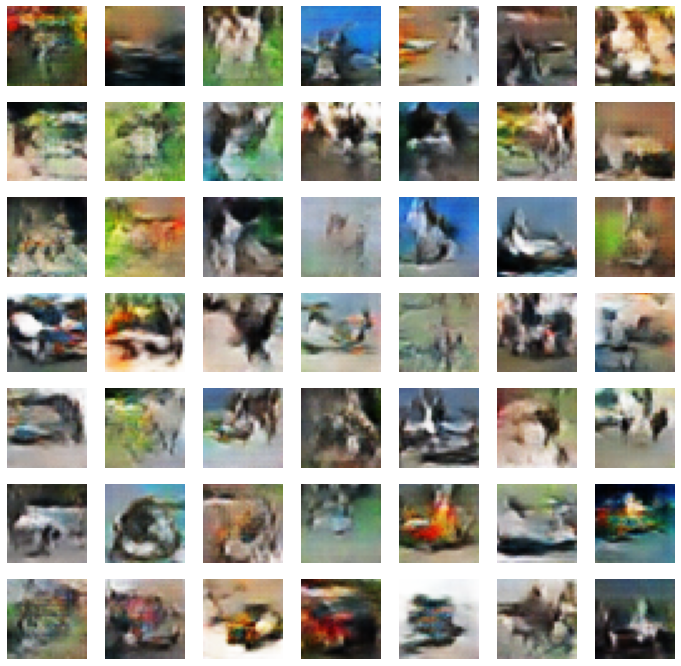

>411, 1/39, d1=0.688, d2=0.692 g=0.731
>411, 2/39, d1=0.694, d2=0.700 g=0.714
>411, 3/39, d1=0.688, d2=0.701 g=0.707
>411, 4/39, d1=0.684, d2=0.727 g=0.707
>411, 5/39, d1=0.678, d2=0.694 g=0.719
>411, 6/39, d1=0.694, d2=0.680 g=0.732
>411, 7/39, d1=0.703, d2=0.690 g=0.745
>411, 8/39, d1=0.688, d2=0.688 g=0.759
>411, 9/39, d1=0.686, d2=0.666 g=0.766
>411, 10/39, d1=0.682, d2=0.641 g=0.774
>411, 11/39, d1=0.683, d2=0.648 g=0.774
>411, 12/39, d1=0.705, d2=0.657 g=0.777
>411, 13/39, d1=0.690, d2=0.677 g=0.747
>411, 14/39, d1=0.700, d2=0.693 g=0.722
>411, 15/39, d1=0.680, d2=0.692 g=0.736
>411, 16/39, d1=0.671, d2=0.702 g=0.748
>411, 17/39, d1=0.682, d2=0.714 g=0.728
>411, 18/39, d1=0.714, d2=0.700 g=0.713
>411, 19/39, d1=0.679, d2=0.700 g=0.732
>411, 20/39, d1=0.692, d2=0.690 g=0.763
>411, 21/39, d1=0.674, d2=0.695 g=0.725
>411, 22/39, d1=0.666, d2=0.672 g=0.756
>411, 23/39, d1=0.713, d2=0.728 g=0.736
>411, 24/39, d1=0.709, d2=0.670 g=0.735
>411, 25/39, d1=0.697, d2=0.697 g=0.741
>411, 26/

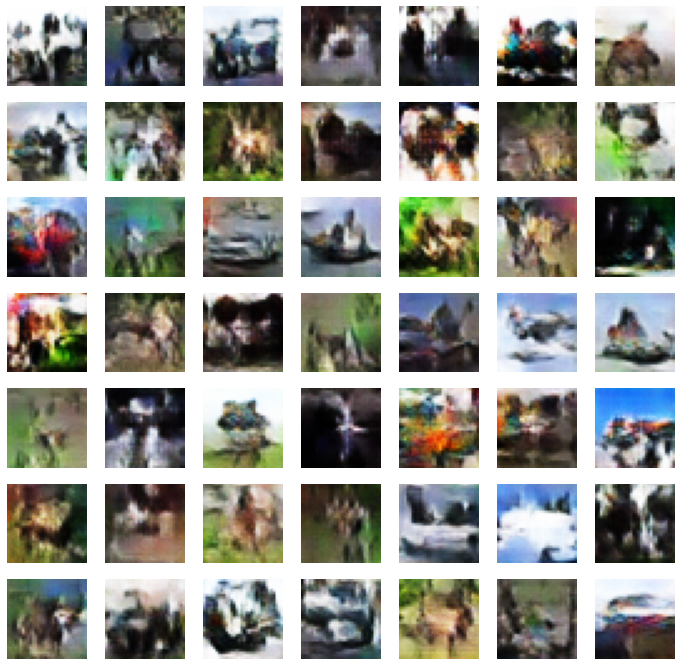

>421, 1/39, d1=0.712, d2=0.648 g=0.781
>421, 2/39, d1=0.681, d2=0.619 g=0.774
>421, 3/39, d1=0.689, d2=0.658 g=0.777
>421, 4/39, d1=0.708, d2=0.664 g=0.769
>421, 5/39, d1=0.684, d2=0.682 g=0.738
>421, 6/39, d1=0.706, d2=0.703 g=0.717
>421, 7/39, d1=0.694, d2=0.702 g=0.726
>421, 8/39, d1=0.702, d2=0.706 g=0.715
>421, 9/39, d1=0.693, d2=0.718 g=0.712
>421, 10/39, d1=0.703, d2=0.694 g=0.726
>421, 11/39, d1=0.689, d2=0.670 g=0.752
>421, 12/39, d1=0.681, d2=0.692 g=0.770
>421, 13/39, d1=0.706, d2=0.669 g=0.774
>421, 14/39, d1=0.663, d2=0.670 g=0.776
>421, 15/39, d1=0.680, d2=0.651 g=0.756
>421, 16/39, d1=0.695, d2=0.702 g=0.757
>421, 17/39, d1=0.695, d2=0.696 g=0.730
>421, 18/39, d1=0.683, d2=0.692 g=0.743
>421, 19/39, d1=0.677, d2=0.678 g=0.724
>421, 20/39, d1=0.706, d2=0.729 g=0.736
>421, 21/39, d1=0.669, d2=0.676 g=0.771
>421, 22/39, d1=0.674, d2=0.662 g=0.740
>421, 23/39, d1=0.698, d2=0.680 g=0.741
>421, 24/39, d1=0.686, d2=0.699 g=0.722
>421, 25/39, d1=0.676, d2=0.722 g=0.735
>421, 26/

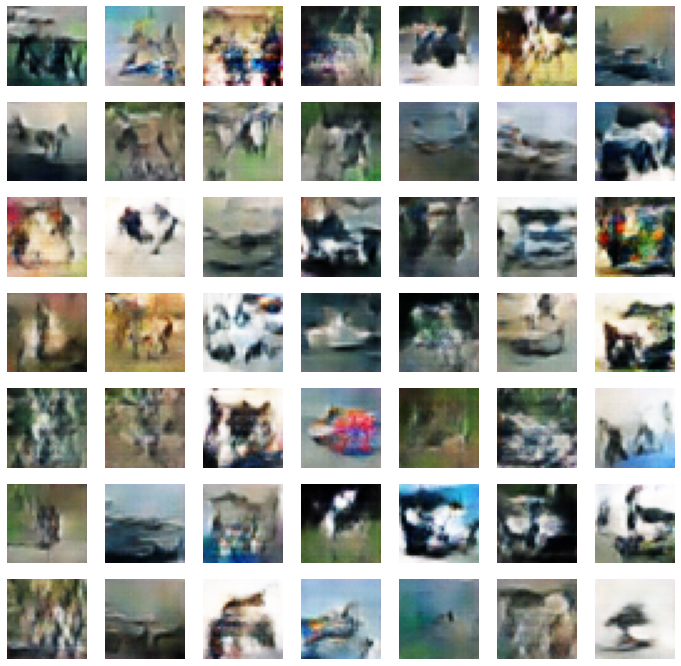

>431, 1/39, d1=0.689, d2=0.696 g=0.726
>431, 2/39, d1=0.681, d2=0.674 g=0.719
>431, 3/39, d1=0.710, d2=0.672 g=0.755
>431, 4/39, d1=0.674, d2=0.676 g=0.730
>431, 5/39, d1=0.688, d2=0.694 g=0.733
>431, 6/39, d1=0.702, d2=0.707 g=0.727
>431, 7/39, d1=0.689, d2=0.696 g=0.725
>431, 8/39, d1=0.722, d2=0.687 g=0.725
>431, 9/39, d1=0.682, d2=0.693 g=0.739
>431, 10/39, d1=0.673, d2=0.668 g=0.768
>431, 11/39, d1=0.684, d2=0.679 g=0.777
>431, 12/39, d1=0.707, d2=0.647 g=0.779
>431, 13/39, d1=0.677, d2=0.662 g=0.763
>431, 14/39, d1=0.699, d2=0.637 g=0.765
>431, 15/39, d1=0.713, d2=0.636 g=0.800
>431, 16/39, d1=0.708, d2=0.723 g=0.739
>431, 17/39, d1=0.674, d2=0.678 g=0.743
>431, 18/39, d1=0.715, d2=0.695 g=0.753
>431, 19/39, d1=0.703, d2=0.651 g=0.753
>431, 20/39, d1=0.672, d2=0.665 g=0.753
>431, 21/39, d1=0.688, d2=0.637 g=0.740
>431, 22/39, d1=0.674, d2=0.682 g=0.749
>431, 23/39, d1=0.696, d2=0.678 g=0.727
>431, 24/39, d1=0.674, d2=0.708 g=0.726
>431, 25/39, d1=0.627, d2=0.704 g=0.712
>431, 26/

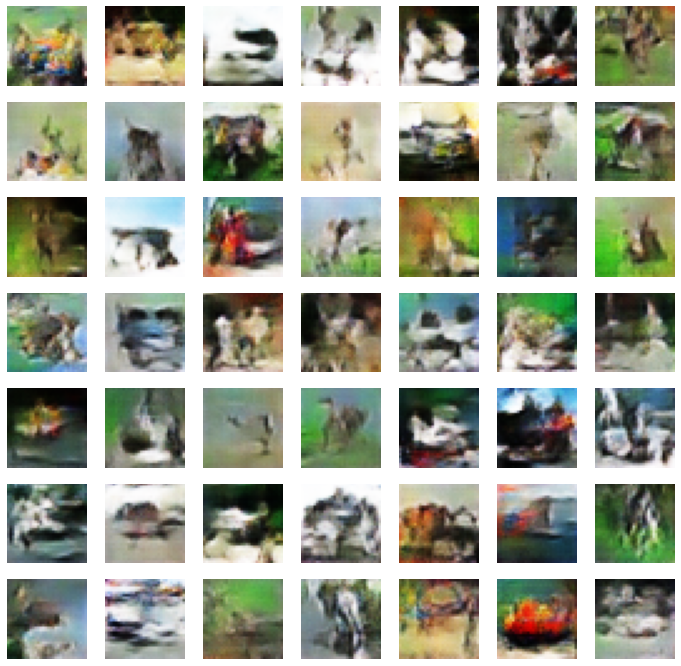

>441, 1/39, d1=0.677, d2=0.663 g=0.745
>441, 2/39, d1=0.707, d2=0.685 g=0.719
>441, 3/39, d1=0.705, d2=0.691 g=0.732
>441, 4/39, d1=0.691, d2=0.692 g=0.713
>441, 5/39, d1=0.648, d2=0.697 g=0.729
>441, 6/39, d1=0.676, d2=0.691 g=0.724
>441, 7/39, d1=0.690, d2=0.678 g=0.718
>441, 8/39, d1=0.677, d2=0.683 g=0.725
>441, 9/39, d1=0.688, d2=0.703 g=0.726
>441, 10/39, d1=0.672, d2=0.681 g=0.726
>441, 11/39, d1=0.672, d2=0.694 g=0.726
>441, 12/39, d1=0.677, d2=0.684 g=0.742
>441, 13/39, d1=0.681, d2=0.666 g=0.753
>441, 14/39, d1=0.718, d2=0.646 g=0.774
>441, 15/39, d1=0.664, d2=0.663 g=0.766
>441, 16/39, d1=0.675, d2=0.652 g=0.776
>441, 17/39, d1=0.653, d2=0.623 g=0.779
>441, 18/39, d1=0.681, d2=0.685 g=0.746
>441, 19/39, d1=0.667, d2=0.719 g=0.724
>441, 20/39, d1=0.683, d2=0.732 g=0.720
>441, 21/39, d1=0.680, d2=0.689 g=0.728
>441, 22/39, d1=0.693, d2=0.687 g=0.739
>441, 23/39, d1=0.688, d2=0.720 g=0.716
>441, 24/39, d1=0.686, d2=0.746 g=0.720
>441, 25/39, d1=0.712, d2=0.707 g=0.725
>441, 26/

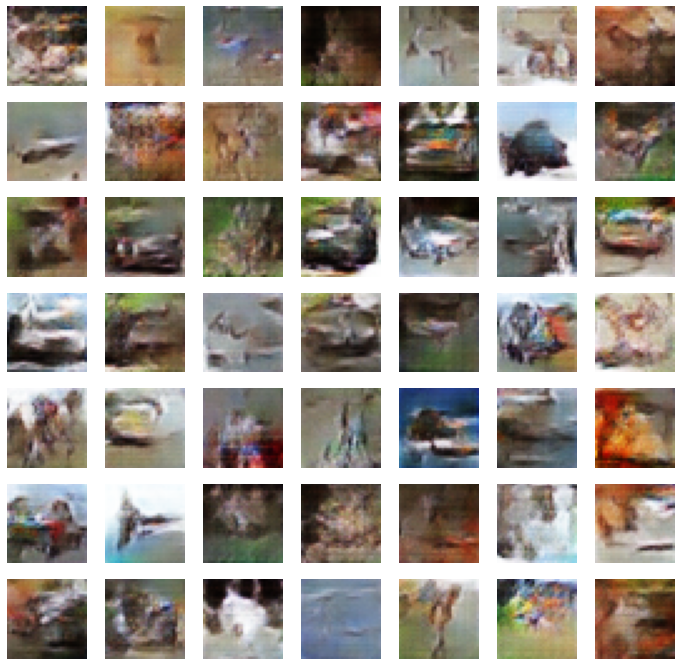

>451, 1/39, d1=0.715, d2=0.682 g=0.735
>451, 2/39, d1=0.712, d2=0.681 g=0.714
>451, 3/39, d1=0.701, d2=0.717 g=0.704
>451, 4/39, d1=0.681, d2=0.688 g=0.715
>451, 5/39, d1=0.680, d2=0.701 g=0.742
>451, 6/39, d1=0.691, d2=0.679 g=0.780
>451, 7/39, d1=0.689, d2=0.640 g=0.776
>451, 8/39, d1=0.675, d2=0.643 g=0.786
>451, 9/39, d1=0.666, d2=0.619 g=0.784
>451, 10/39, d1=0.675, d2=0.672 g=0.779
>451, 11/39, d1=0.685, d2=0.693 g=0.767
>451, 12/39, d1=0.692, d2=0.691 g=0.734
>451, 13/39, d1=0.660, d2=0.711 g=0.720
>451, 14/39, d1=0.699, d2=0.741 g=0.720
>451, 15/39, d1=0.717, d2=0.692 g=0.760
>451, 16/39, d1=0.690, d2=0.694 g=0.759
>451, 17/39, d1=0.684, d2=0.689 g=0.757
>451, 18/39, d1=0.681, d2=0.635 g=0.772
>451, 19/39, d1=0.716, d2=0.662 g=0.796
>451, 20/39, d1=0.692, d2=0.660 g=0.754
>451, 21/39, d1=0.685, d2=0.668 g=0.759
>451, 22/39, d1=0.683, d2=0.697 g=0.743
>451, 23/39, d1=0.681, d2=0.735 g=0.750
>451, 24/39, d1=0.693, d2=0.657 g=0.735
>451, 25/39, d1=0.688, d2=0.675 g=0.746
>451, 26/

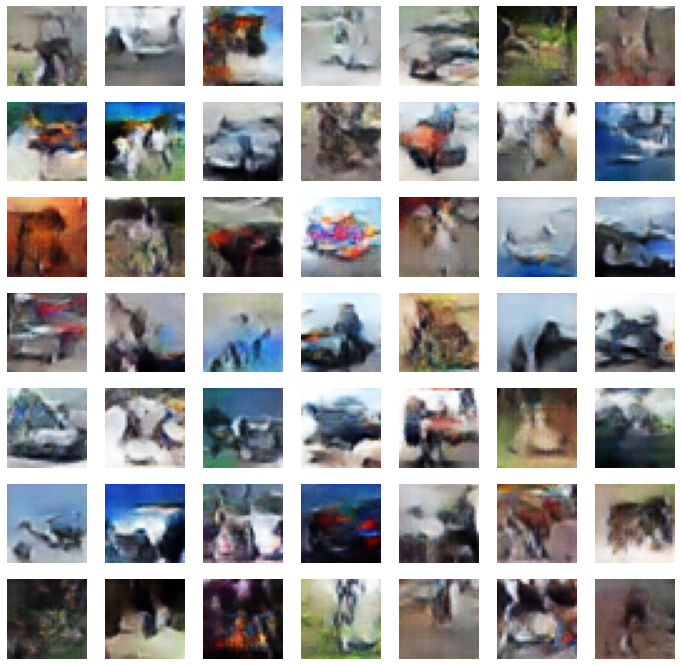

>461, 1/39, d1=0.684, d2=0.670 g=0.738
>461, 2/39, d1=0.659, d2=0.680 g=0.727
>461, 3/39, d1=0.701, d2=0.703 g=0.705
>461, 4/39, d1=0.676, d2=0.709 g=0.708
>461, 5/39, d1=0.692, d2=0.741 g=0.709
>461, 6/39, d1=0.673, d2=0.725 g=0.707
>461, 7/39, d1=0.665, d2=0.711 g=0.721
>461, 8/39, d1=0.697, d2=0.670 g=0.727
>461, 9/39, d1=0.666, d2=0.673 g=0.747
>461, 10/39, d1=0.678, d2=0.679 g=0.741
>461, 11/39, d1=0.665, d2=0.677 g=0.750
>461, 12/39, d1=0.632, d2=0.688 g=0.764
>461, 13/39, d1=0.686, d2=0.665 g=0.735
>461, 14/39, d1=0.693, d2=0.671 g=0.773
>461, 15/39, d1=0.668, d2=0.698 g=0.742
>461, 16/39, d1=0.716, d2=0.671 g=0.748
>461, 17/39, d1=0.686, d2=0.661 g=0.748
>461, 18/39, d1=0.694, d2=0.713 g=0.723
>461, 19/39, d1=0.674, d2=0.677 g=0.750
>461, 20/39, d1=0.697, d2=0.687 g=0.746
>461, 21/39, d1=0.712, d2=0.676 g=0.745
>461, 22/39, d1=0.672, d2=0.688 g=0.734
>461, 23/39, d1=0.706, d2=0.673 g=0.724
>461, 24/39, d1=0.687, d2=0.694 g=0.743
>461, 25/39, d1=0.684, d2=0.687 g=0.752
>461, 26/

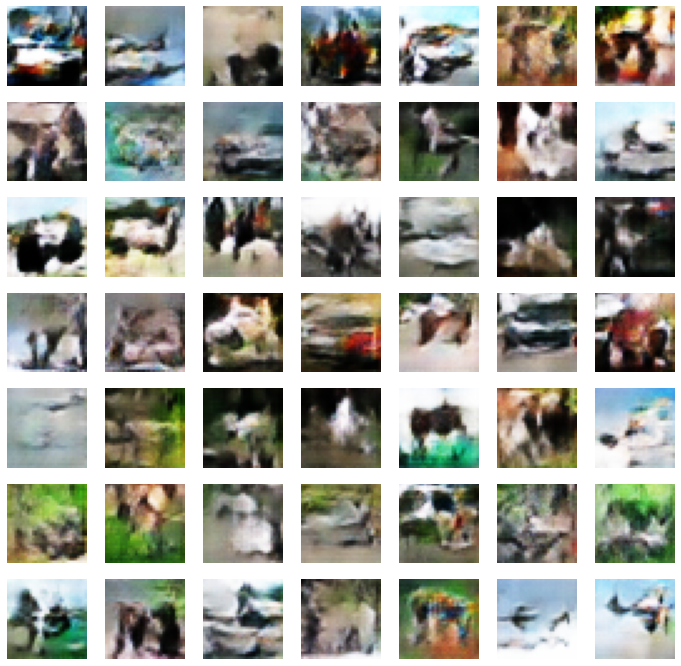

>471, 1/39, d1=0.694, d2=0.682 g=0.770
>471, 2/39, d1=0.734, d2=0.657 g=0.743
>471, 3/39, d1=0.693, d2=0.650 g=0.785
>471, 4/39, d1=0.692, d2=0.661 g=0.757
>471, 5/39, d1=0.691, d2=0.650 g=0.786
>471, 6/39, d1=0.696, d2=0.664 g=0.812
>471, 7/39, d1=0.710, d2=0.670 g=0.765
>471, 8/39, d1=0.735, d2=0.680 g=0.782
>471, 9/39, d1=0.700, d2=0.674 g=0.746
>471, 10/39, d1=0.713, d2=0.692 g=0.732
>471, 11/39, d1=0.702, d2=0.703 g=0.726
>471, 12/39, d1=0.688, d2=0.693 g=0.697
>471, 13/39, d1=0.690, d2=0.700 g=0.722
>471, 14/39, d1=0.667, d2=0.711 g=0.708
>471, 15/39, d1=0.693, d2=0.685 g=0.743
>471, 16/39, d1=0.693, d2=0.672 g=0.730
>471, 17/39, d1=0.668, d2=0.673 g=0.735
>471, 18/39, d1=0.676, d2=0.660 g=0.761
>471, 19/39, d1=0.672, d2=0.639 g=0.773
>471, 20/39, d1=0.661, d2=0.643 g=0.772
>471, 21/39, d1=0.651, d2=0.648 g=0.759
>471, 22/39, d1=0.710, d2=0.665 g=0.757
>471, 23/39, d1=0.641, d2=0.677 g=0.716
>471, 24/39, d1=0.656, d2=0.719 g=0.706
>471, 25/39, d1=0.659, d2=0.702 g=0.712
>471, 26/

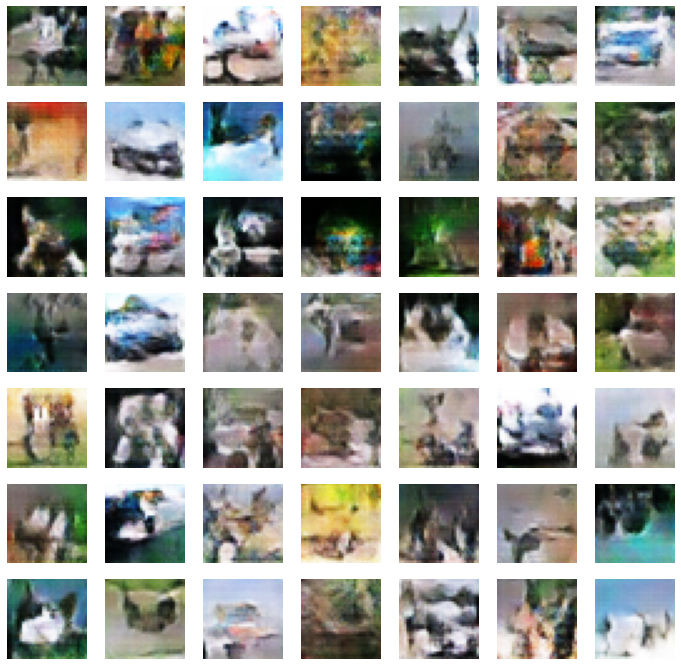

>481, 1/39, d1=0.668, d2=0.692 g=0.740
>481, 2/39, d1=0.707, d2=0.661 g=0.746
>481, 3/39, d1=0.688, d2=0.707 g=0.756
>481, 4/39, d1=0.684, d2=0.702 g=0.761
>481, 5/39, d1=0.678, d2=0.665 g=0.756
>481, 6/39, d1=0.714, d2=0.694 g=0.769
>481, 7/39, d1=0.709, d2=0.663 g=0.756
>481, 8/39, d1=0.704, d2=0.670 g=0.750
>481, 9/39, d1=0.682, d2=0.678 g=0.731
>481, 10/39, d1=0.707, d2=0.682 g=0.722
>481, 11/39, d1=0.679, d2=0.700 g=0.743
>481, 12/39, d1=0.697, d2=0.689 g=0.745
>481, 13/39, d1=0.640, d2=0.679 g=0.728
>481, 14/39, d1=0.696, d2=0.699 g=0.746
>481, 15/39, d1=0.711, d2=0.675 g=0.722
>481, 16/39, d1=0.701, d2=0.686 g=0.744
>481, 17/39, d1=0.695, d2=0.672 g=0.737
>481, 18/39, d1=0.684, d2=0.683 g=0.770
>481, 19/39, d1=0.701, d2=0.677 g=0.770
>481, 20/39, d1=0.684, d2=0.697 g=0.744
>481, 21/39, d1=0.633, d2=0.681 g=0.748
>481, 22/39, d1=0.695, d2=0.716 g=0.719
>481, 23/39, d1=0.684, d2=0.705 g=0.716
>481, 24/39, d1=0.653, d2=0.705 g=0.723
>481, 25/39, d1=0.678, d2=0.740 g=0.716
>481, 26/

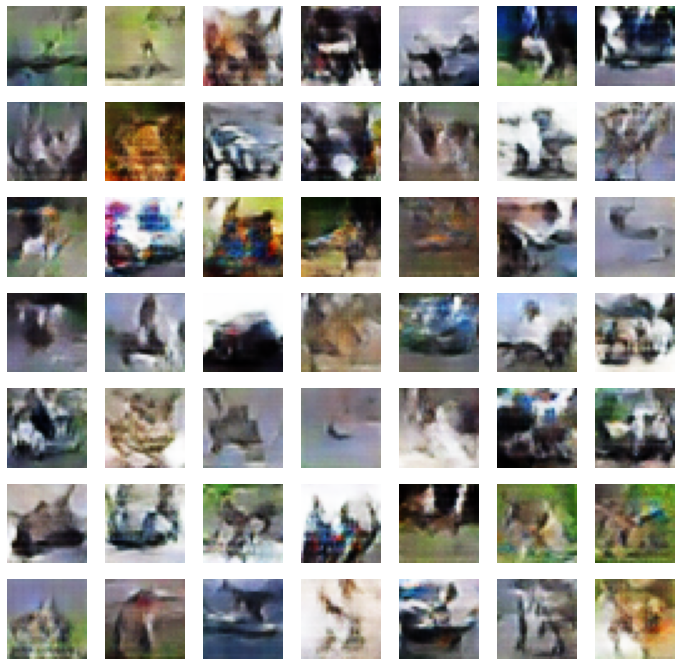

>491, 1/39, d1=0.654, d2=0.721 g=0.751
>491, 2/39, d1=0.673, d2=0.704 g=0.738
>491, 3/39, d1=0.670, d2=0.691 g=0.734
>491, 4/39, d1=0.680, d2=0.695 g=0.738
>491, 5/39, d1=0.671, d2=0.707 g=0.730
>491, 6/39, d1=0.710, d2=0.715 g=0.732
>491, 7/39, d1=0.692, d2=0.741 g=0.696
>491, 8/39, d1=0.684, d2=0.729 g=0.707
>491, 9/39, d1=0.678, d2=0.707 g=0.742
>491, 10/39, d1=0.675, d2=0.687 g=0.734
>491, 11/39, d1=0.689, d2=0.671 g=0.757
>491, 12/39, d1=0.722, d2=0.687 g=0.755
>491, 13/39, d1=0.717, d2=0.636 g=0.793
>491, 14/39, d1=0.695, d2=0.637 g=0.800
>491, 15/39, d1=0.706, d2=0.642 g=0.798
>491, 16/39, d1=0.695, d2=0.633 g=0.785
>491, 17/39, d1=0.691, d2=0.665 g=0.771
>491, 18/39, d1=0.689, d2=0.681 g=0.749
>491, 19/39, d1=0.682, d2=0.736 g=0.738
>491, 20/39, d1=0.697, d2=0.704 g=0.735
>491, 21/39, d1=0.660, d2=0.710 g=0.734
>491, 22/39, d1=0.700, d2=0.690 g=0.761
>491, 23/39, d1=0.701, d2=0.706 g=0.730
>491, 24/39, d1=0.710, d2=0.701 g=0.729
>491, 25/39, d1=0.670, d2=0.672 g=0.735
>491, 26/

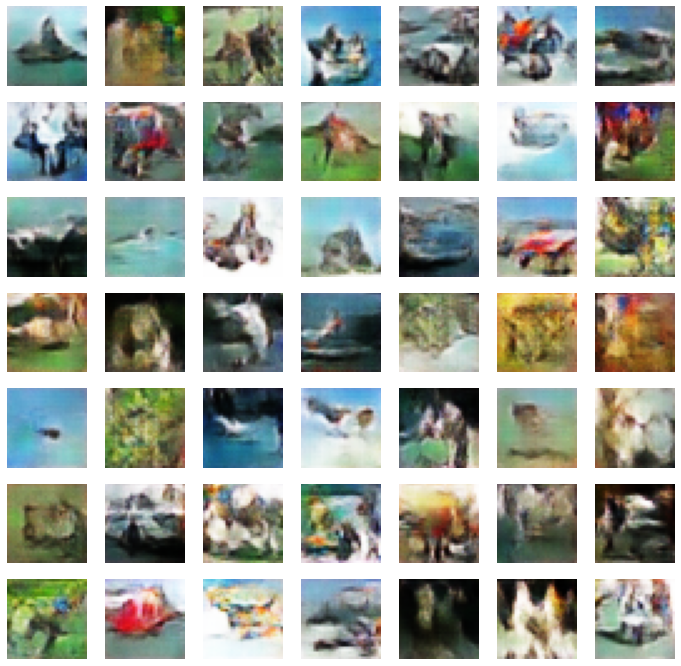

In [ ]:
latent_dim = 100                                        # Give the input length of the generator model
d_model = define_discriminator()                        # Create the discriminator
g_model = define_generator(latent_dim)                  # Create the generator
gan_model = define_gan(g_model, d_model)                # Create the gan
dataset = load_real_samples()                           # Load real images
train(g_model, d_model, gan_model, dataset, latent_dim) # Train model using the parameters

# Generate some fake images using the Generator

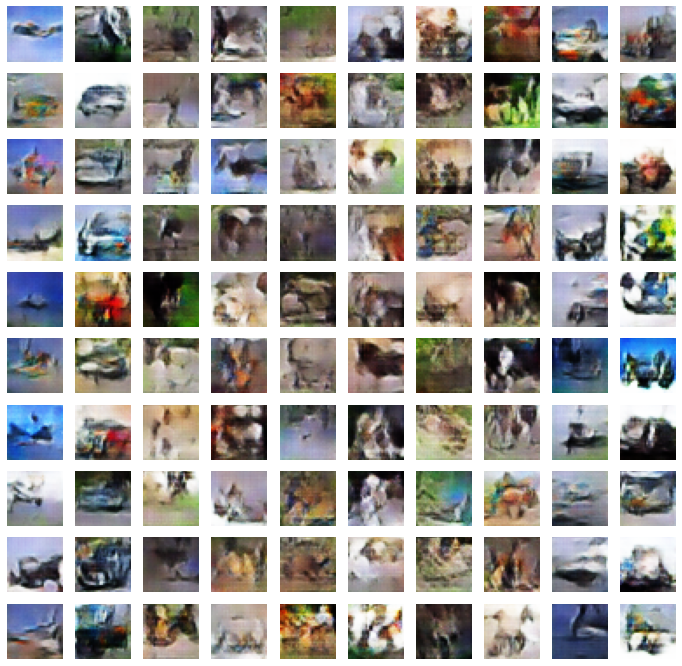

In [ ]:
model = keras.models.load_model('generator_model_490.h5')       # Load model
latent_points, labels = generate_latent_points(100, 100)        # Generate inputs
labels = np.asarray([x for _ in range(10) for x in range(10)])  # Generate labels
X  = model.predict([latent_points, labels])                     # Generate images
plot_generate(X, 10)                                            # Plot the result